<a href="https://colab.research.google.com/github/RipeMangoBox/BlogLearning/blob/master/vae_pytorch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Step 1 - Configuration Setup

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm
from torchvision import datasets, transforms

batch_size = 100
original_dim = 784
latent_dim = 2
intermediate_dim = 256
epochs = 50

# 加载MNIST数据集
transform = transforms.Compose([transforms.ToTensor(), transforms.Lambda(lambda x: x.view(-1))])
train_loader = torch.utils.data.DataLoader(datasets.MNIST('data', train=True, download=True, transform=transform),
                                           batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(datasets.MNIST('data', train=False, transform=transform),
                                          batch_size=batch_size, shuffle=True)

100%|██████████| 9912422/9912422 [00:00<00:00, 108774864.72it/s]


Extracting data/MNIST/raw/train-images-idx3-ubyte.gz to data/MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 137031327.86it/s]


Extracting data/MNIST/raw/train-labels-idx1-ubyte.gz to data/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 38350032.14it/s]


Extracting data/MNIST/raw/t10k-images-idx3-ubyte.gz to data/MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 1145345.32it/s]


Extracting data/MNIST/raw/t10k-labels-idx1-ubyte.gz to data/MNIST/raw



# Step 2 - VAE Model

In [13]:
class VAE(nn.Module):
  def __init__(self):
    super(VAE, self).__init__()

    # UNet structure
    self.fc1 = nn.Linear(original_dim, intermediate_dim)
    self.z_mean = nn.Linear(intermediate_dim, latent_dim)
    self.z_log_var = nn.Linear(intermediate_dim, latent_dim)
    self.fc3 = nn.Linear(latent_dim, intermediate_dim)
    self.fc4 = nn.Linear(intermediate_dim, original_dim)

  def encode(self, x):
    h1 = F.relu(self.fc1(x))
    return self.z_mean(h1), self.z_log_var(h1)

  def reparameterize(self, mu, logvar):
    std = torch.exp(0.5 * logvar)
    eps = torch.randn_like(std)
    return mu + eps * std

  def decode(self, z):
    h3 = F.relu(self.fc3(z))
    return torch.sigmoid(self.fc4(h3))

  def forward(self, x):
    mu, logvar = self.encode(x)
    z = self.reparameterize(mu, logvar)
    return self.decode(z), mu, logvar

In [14]:
def loss_function(recon_x, x, mu, logvar):
  BCE = F.binary_cross_entropy(recon_x, x.view(-1, 784), reduction='sum') # reconstruction loss
  KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp()) # KL loss
  return torch.mean(BCE + KLD)


def train(epoch):
  model.train()
  train_loss = 0
  for batch_idx, (data, _) in enumerate(train_loader):
    optimizer.zero_grad()
    recon_batch, mu, logvar = model(data)
    loss = loss_function(recon_batch, data, mu, logvar)
    loss.backward()
    train_loss += loss.item()
    optimizer.step()
    if batch_idx % 100 == 0:
      print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
        epoch, batch_idx * len(data), len(train_loader.dataset),
        100. * batch_idx / len(train_loader),
        loss.item() / len(data)))

  print('====> Epoch: {} Average loss: {:.4f}'.format(
      epoch, train_loss / len(train_loader.dataset)))


def test(epoch):
  model.eval()
  test_loss = 0
  with torch.no_grad():
    for i, (data, _) in enumerate(test_loader):
      recon_batch, mu, logvar = model(data)
      test_loss += loss_function(recon_batch, data, mu, logvar).item()
      # if i == 0:
      #   n = min(data.size(0), 8)
      #   comparison = torch.cat([data[:n], recon_batch.view(batch_size, 1, 28, 28)[:n]])
      #   save_image(comparison.cpu(), 'results/reconstruction_' + str(epoch) + '.png', nrow=n)

  test_loss /= len(test_loader.dataset)
  print('====> Test set loss: {:.4f}'.format(test_loss))

# Step 3 - Visualization

In [15]:
def plot_latent_space(epoch):
  with torch.no_grad():
    for i, (data, labels) in enumerate(test_loader):
      mu, logvar = model.encode(data)
      z = model.reparameterize(mu, logvar)
      plt.figure(figsize=(6, 6))
      plt.scatter(z[:, 0], z[:, 1], c=labels.numpy())
      plt.colorbar()
      plt.xlabel("z[0]")
      plt.ylabel("z[1]")
      # plt.savefig("results/latent_space_" + str(epoch) + ".png")
      plt.show()
      break

def plot_generated_images(epoch):
  with torch.no_grad():
    n = 15
    digit_size = 28
    figure = np.zeros((digit_size * n, digit_size * n))
    grid_x = norm.ppf(np.linspace(0.05, 0.95, n))
    grid_y = norm.ppf(np.linspace(0.05, 0.95, n))
    for i, yi in enumerate(grid_x):
      for j, xi in enumerate(grid_y):
        z_sample = torch.tensor([[xi, yi]]).float()
        z_sample = z_sample.to(device)
        x_decoded = model.decode(z_sample)
        digit = x_decoded.view(digit_size, digit_size).cpu().numpy()
        figure[i * digit_size: (i + 1) * digit_size,
              j * digit_size: (j + 1) * digit_size] = digit
    plt.figure(figsize=(10, 10))
    plt.imshow(figure, cmap='Greys_r')
    # plt.savefig("results/generated_images_" + str(epoch) + ".png")
    plt.show()

Train Epoch: 1 [0/60000 (0%)]	Loss: 550.745703
Train Epoch: 1 [10000/60000 (17%)]	Loss: 202.524785
Train Epoch: 1 [20000/60000 (33%)]	Loss: 180.822695
Train Epoch: 1 [30000/60000 (50%)]	Loss: 186.503359
Train Epoch: 1 [40000/60000 (67%)]	Loss: 179.454512
Train Epoch: 1 [50000/60000 (83%)]	Loss: 174.214863
====> Epoch: 1 Average loss: 191.4266
====> Test set loss: 171.3859


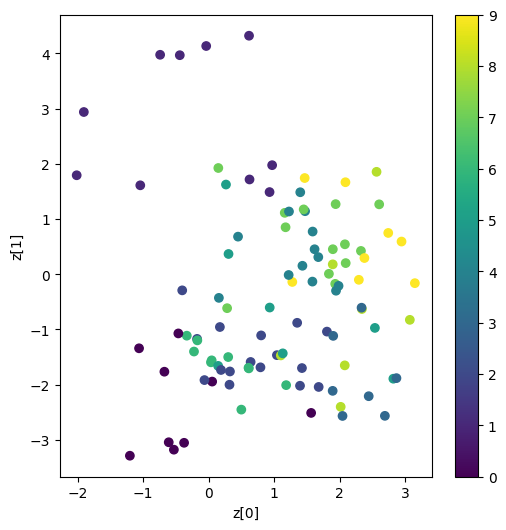

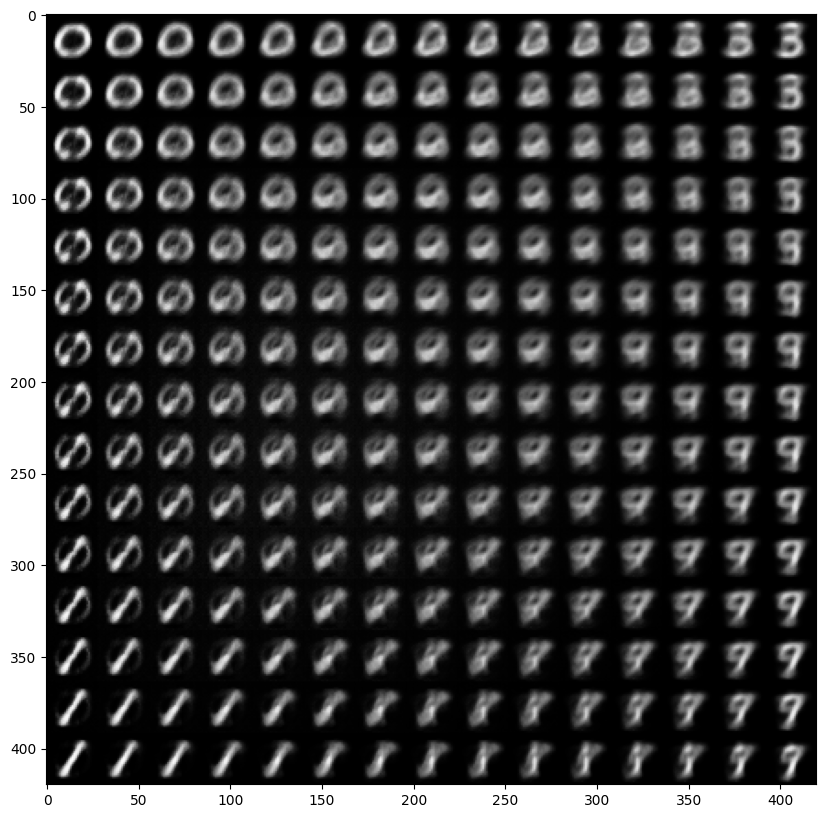

Train Epoch: 2 [0/60000 (0%)]	Loss: 173.113027
Train Epoch: 2 [10000/60000 (17%)]	Loss: 172.150859
Train Epoch: 2 [20000/60000 (33%)]	Loss: 169.755488
Train Epoch: 2 [30000/60000 (50%)]	Loss: 166.716738
Train Epoch: 2 [40000/60000 (67%)]	Loss: 168.609336
Train Epoch: 2 [50000/60000 (83%)]	Loss: 165.250625
====> Epoch: 2 Average loss: 168.7741
====> Test set loss: 165.2204


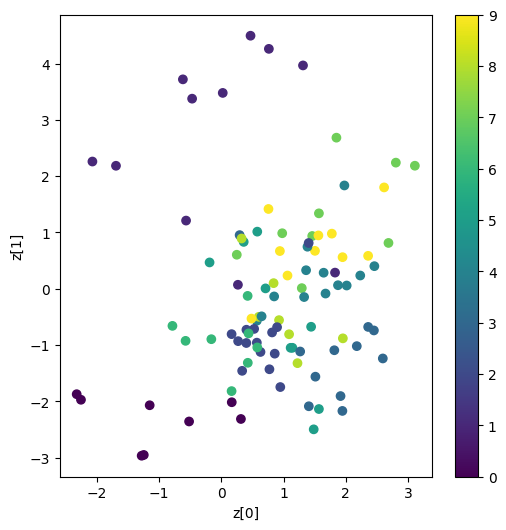

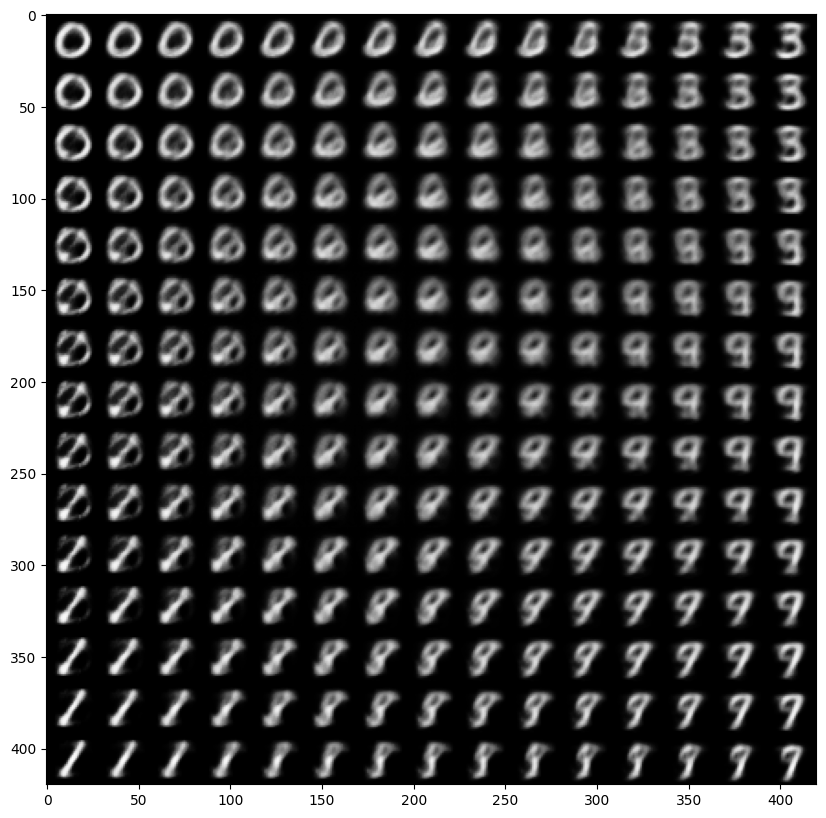

Train Epoch: 3 [0/60000 (0%)]	Loss: 171.200684
Train Epoch: 3 [10000/60000 (17%)]	Loss: 158.606250
Train Epoch: 3 [20000/60000 (33%)]	Loss: 167.917266
Train Epoch: 3 [30000/60000 (50%)]	Loss: 160.713213
Train Epoch: 3 [40000/60000 (67%)]	Loss: 163.522861
Train Epoch: 3 [50000/60000 (83%)]	Loss: 166.280586
====> Epoch: 3 Average loss: 164.4797
====> Test set loss: 162.7999


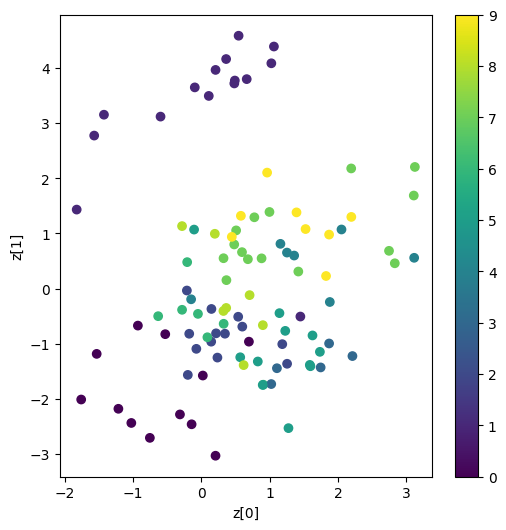

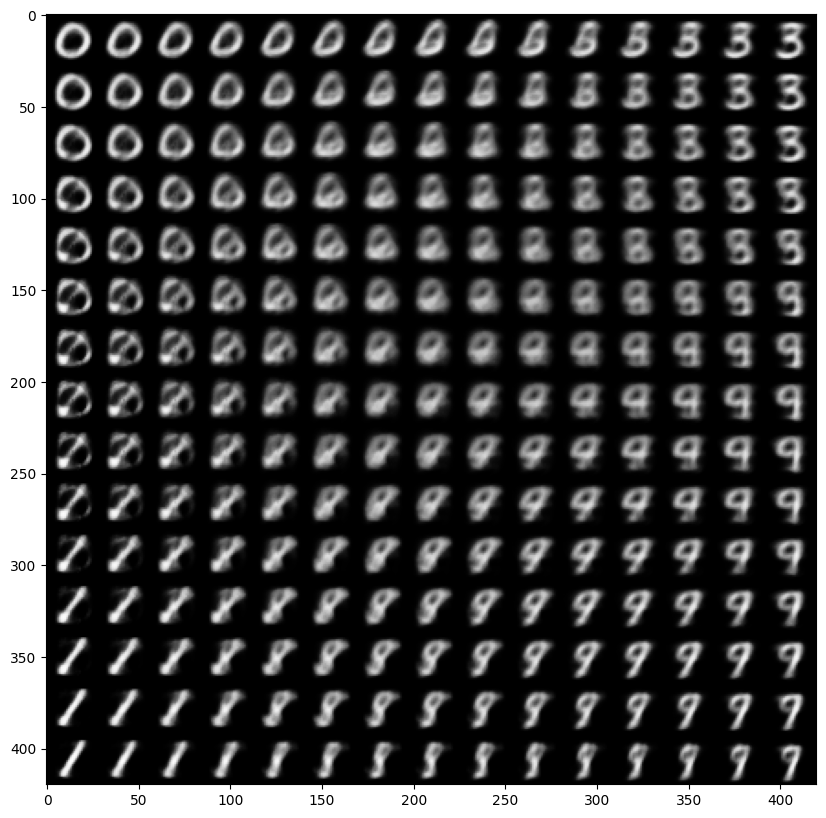

Train Epoch: 4 [0/60000 (0%)]	Loss: 165.650508
Train Epoch: 4 [10000/60000 (17%)]	Loss: 166.631172
Train Epoch: 4 [20000/60000 (33%)]	Loss: 164.800137
Train Epoch: 4 [30000/60000 (50%)]	Loss: 162.689141
Train Epoch: 4 [40000/60000 (67%)]	Loss: 148.932129
Train Epoch: 4 [50000/60000 (83%)]	Loss: 150.281787
====> Epoch: 4 Average loss: 162.2760
====> Test set loss: 161.1467


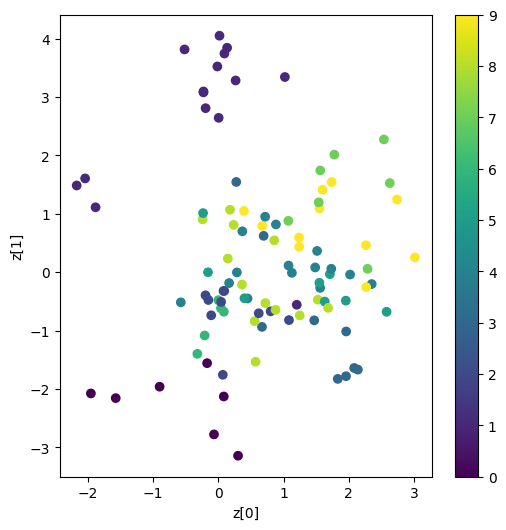

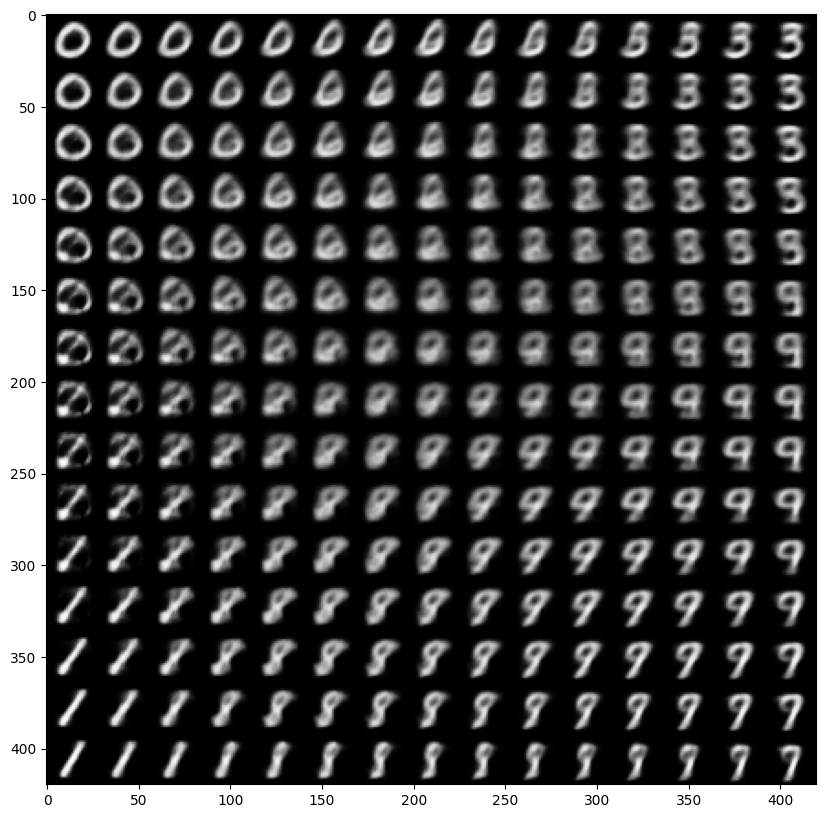

Train Epoch: 5 [0/60000 (0%)]	Loss: 162.502607
Train Epoch: 5 [10000/60000 (17%)]	Loss: 156.445859
Train Epoch: 5 [20000/60000 (33%)]	Loss: 159.207100
Train Epoch: 5 [30000/60000 (50%)]	Loss: 152.490957
Train Epoch: 5 [40000/60000 (67%)]	Loss: 158.574717
Train Epoch: 5 [50000/60000 (83%)]	Loss: 165.214160
====> Epoch: 5 Average loss: 160.7437
====> Test set loss: 159.6091


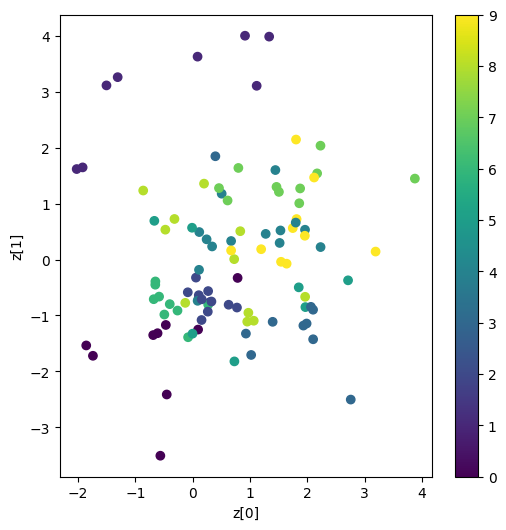

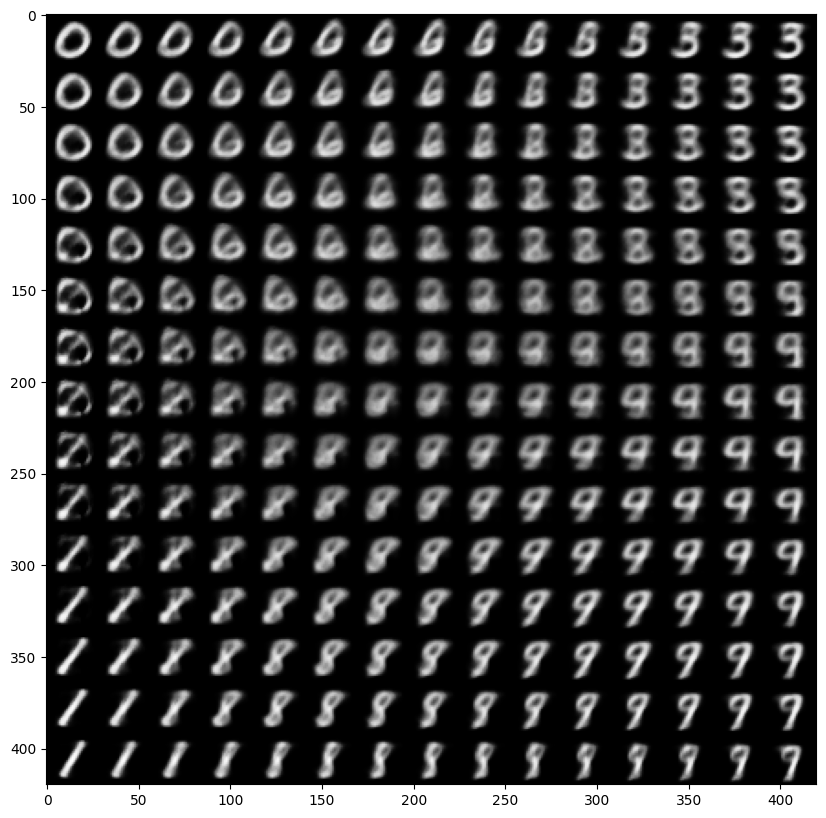

Train Epoch: 6 [0/60000 (0%)]	Loss: 165.242598
Train Epoch: 6 [10000/60000 (17%)]	Loss: 158.021934
Train Epoch: 6 [20000/60000 (33%)]	Loss: 159.041084
Train Epoch: 6 [30000/60000 (50%)]	Loss: 167.094102
Train Epoch: 6 [40000/60000 (67%)]	Loss: 159.287803
Train Epoch: 6 [50000/60000 (83%)]	Loss: 158.726445
====> Epoch: 6 Average loss: 159.5897
====> Test set loss: 159.0451


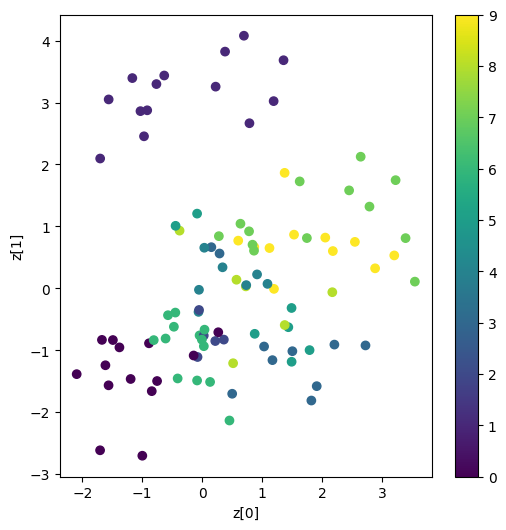

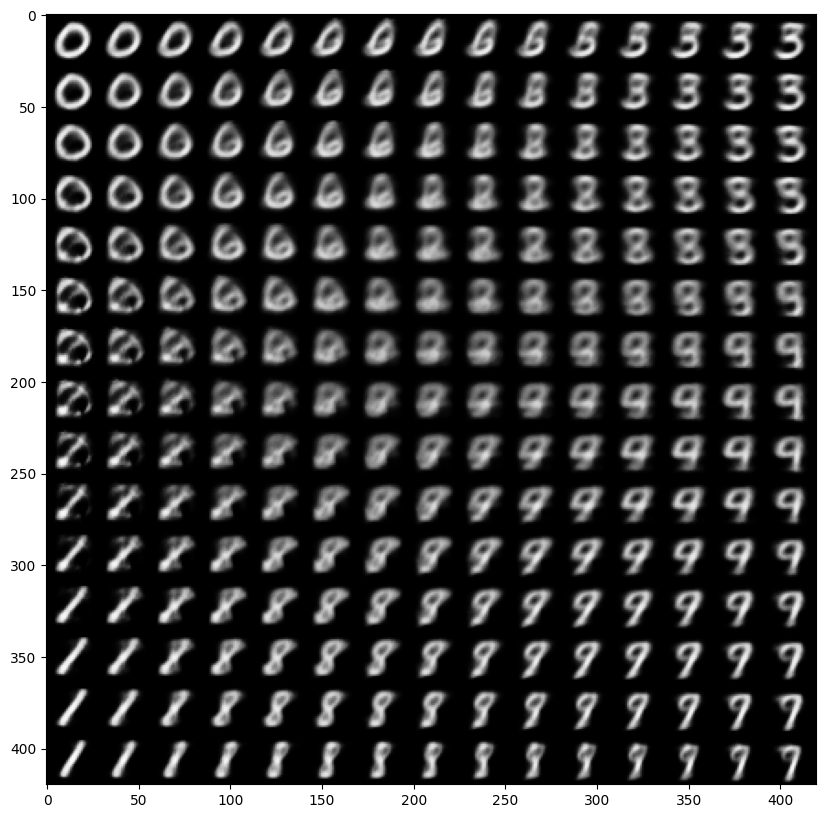

Train Epoch: 7 [0/60000 (0%)]	Loss: 162.227354
Train Epoch: 7 [10000/60000 (17%)]	Loss: 158.858457
Train Epoch: 7 [20000/60000 (33%)]	Loss: 163.455000
Train Epoch: 7 [30000/60000 (50%)]	Loss: 172.033945
Train Epoch: 7 [40000/60000 (67%)]	Loss: 167.062363
Train Epoch: 7 [50000/60000 (83%)]	Loss: 156.454541
====> Epoch: 7 Average loss: 158.6548
====> Test set loss: 158.2451


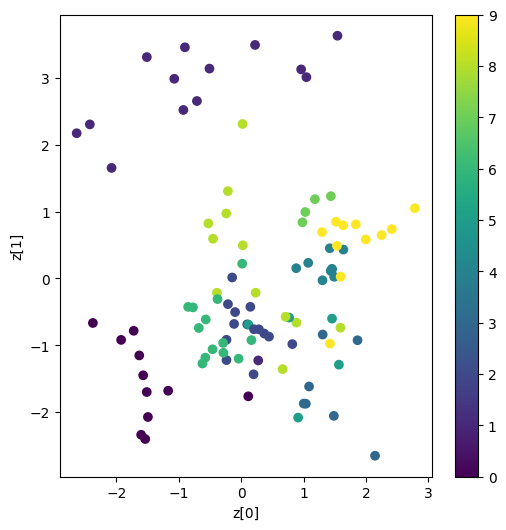

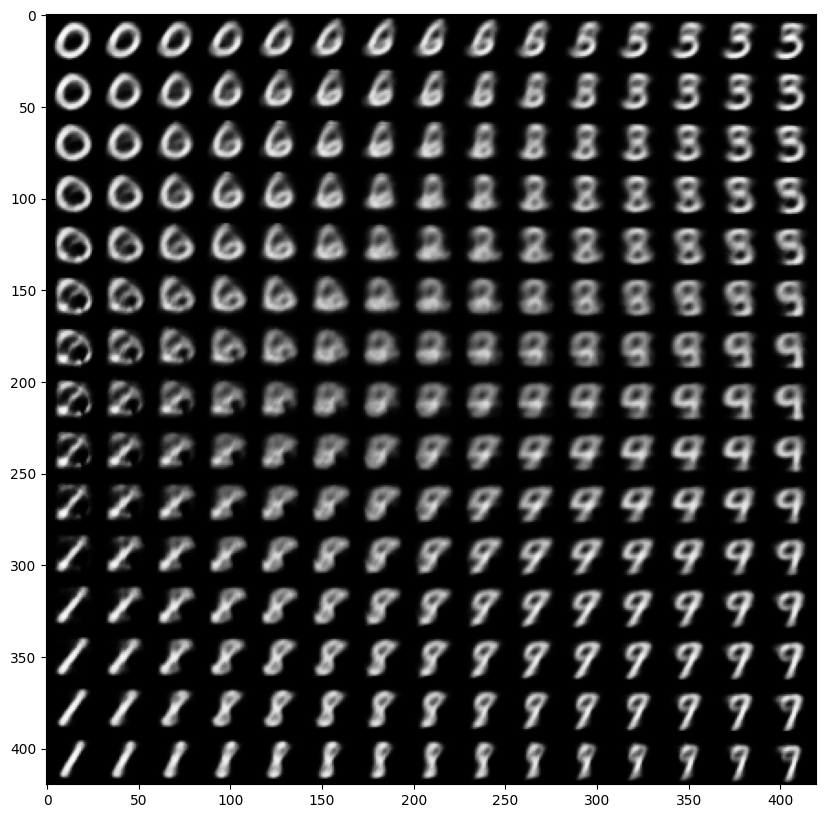

Train Epoch: 8 [0/60000 (0%)]	Loss: 156.238213
Train Epoch: 8 [10000/60000 (17%)]	Loss: 157.696289
Train Epoch: 8 [20000/60000 (33%)]	Loss: 151.482324
Train Epoch: 8 [30000/60000 (50%)]	Loss: 155.841660
Train Epoch: 8 [40000/60000 (67%)]	Loss: 158.925039
Train Epoch: 8 [50000/60000 (83%)]	Loss: 158.558643
====> Epoch: 8 Average loss: 157.8629
====> Test set loss: 157.3591


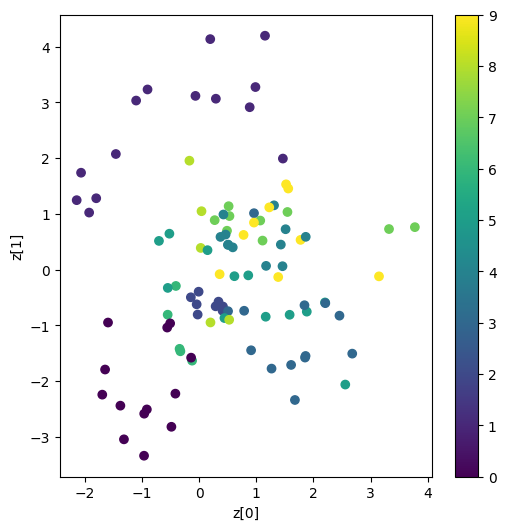

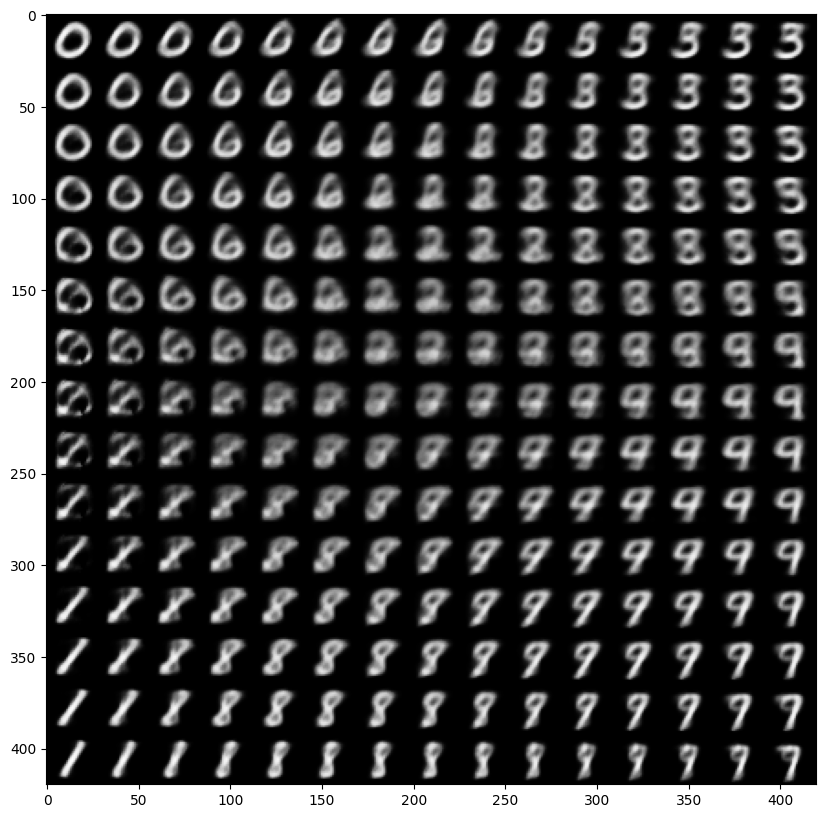

Train Epoch: 9 [0/60000 (0%)]	Loss: 164.629766
Train Epoch: 9 [10000/60000 (17%)]	Loss: 147.666895
Train Epoch: 9 [20000/60000 (33%)]	Loss: 159.267646
Train Epoch: 9 [30000/60000 (50%)]	Loss: 162.068467
Train Epoch: 9 [40000/60000 (67%)]	Loss: 158.505498
Train Epoch: 9 [50000/60000 (83%)]	Loss: 155.405264
====> Epoch: 9 Average loss: 157.0818
====> Test set loss: 156.8558


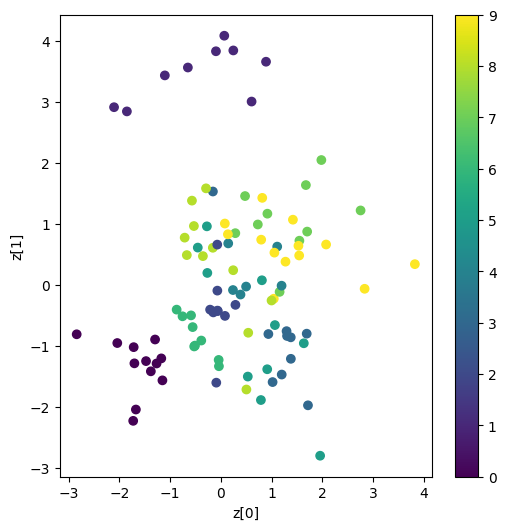

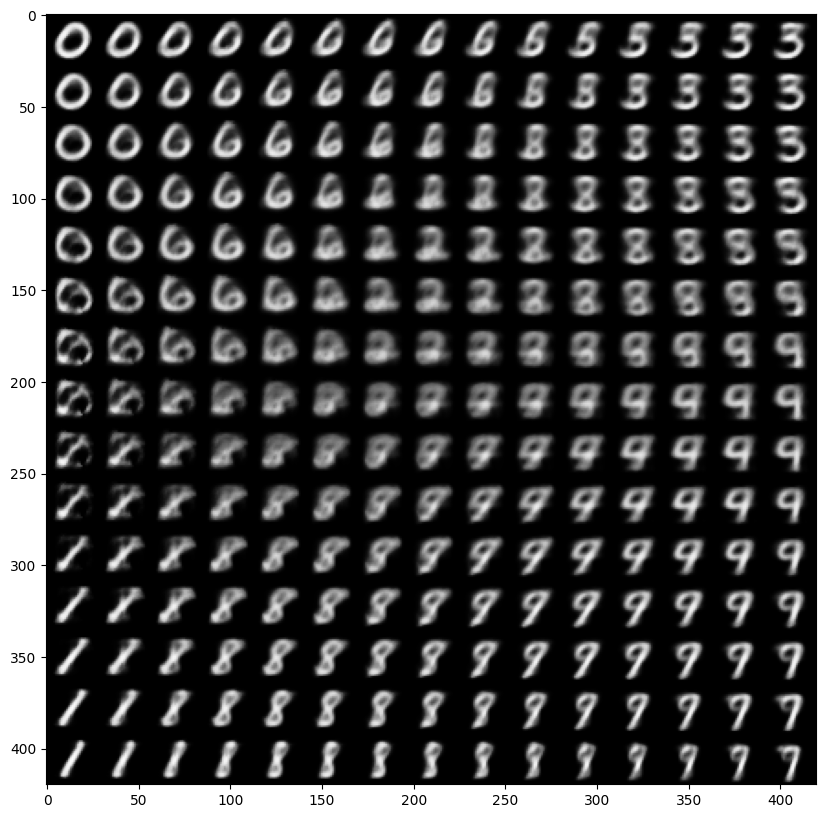

Train Epoch: 10 [0/60000 (0%)]	Loss: 151.141455
Train Epoch: 10 [10000/60000 (17%)]	Loss: 158.300898
Train Epoch: 10 [20000/60000 (33%)]	Loss: 161.777285
Train Epoch: 10 [30000/60000 (50%)]	Loss: 160.030879
Train Epoch: 10 [40000/60000 (67%)]	Loss: 159.516279
Train Epoch: 10 [50000/60000 (83%)]	Loss: 162.621289
====> Epoch: 10 Average loss: 156.4213
====> Test set loss: 156.0275


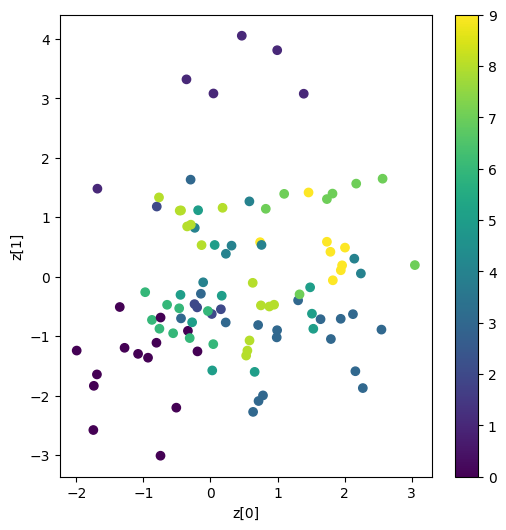

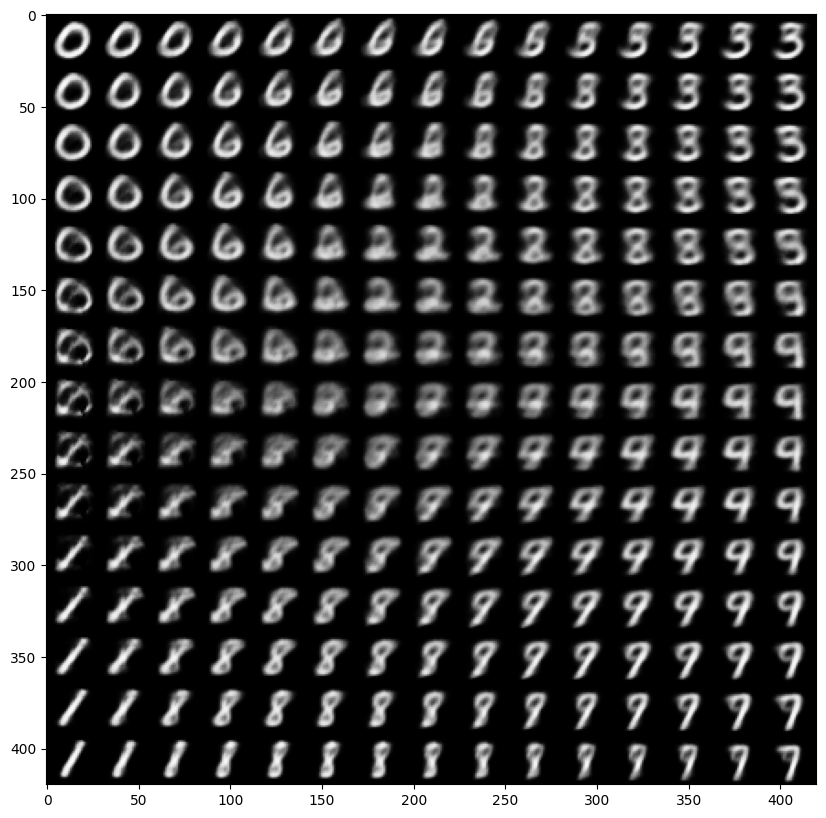

Train Epoch: 11 [0/60000 (0%)]	Loss: 155.847207
Train Epoch: 11 [10000/60000 (17%)]	Loss: 163.536113
Train Epoch: 11 [20000/60000 (33%)]	Loss: 152.314717
Train Epoch: 11 [30000/60000 (50%)]	Loss: 150.488740
Train Epoch: 11 [40000/60000 (67%)]	Loss: 156.787100
Train Epoch: 11 [50000/60000 (83%)]	Loss: 148.623018
====> Epoch: 11 Average loss: 155.8566
====> Test set loss: 155.6162


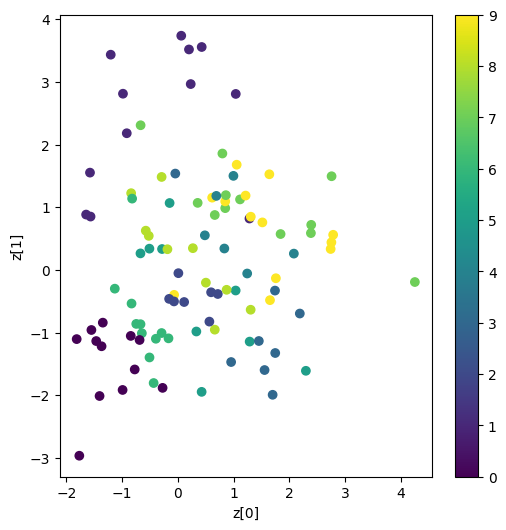

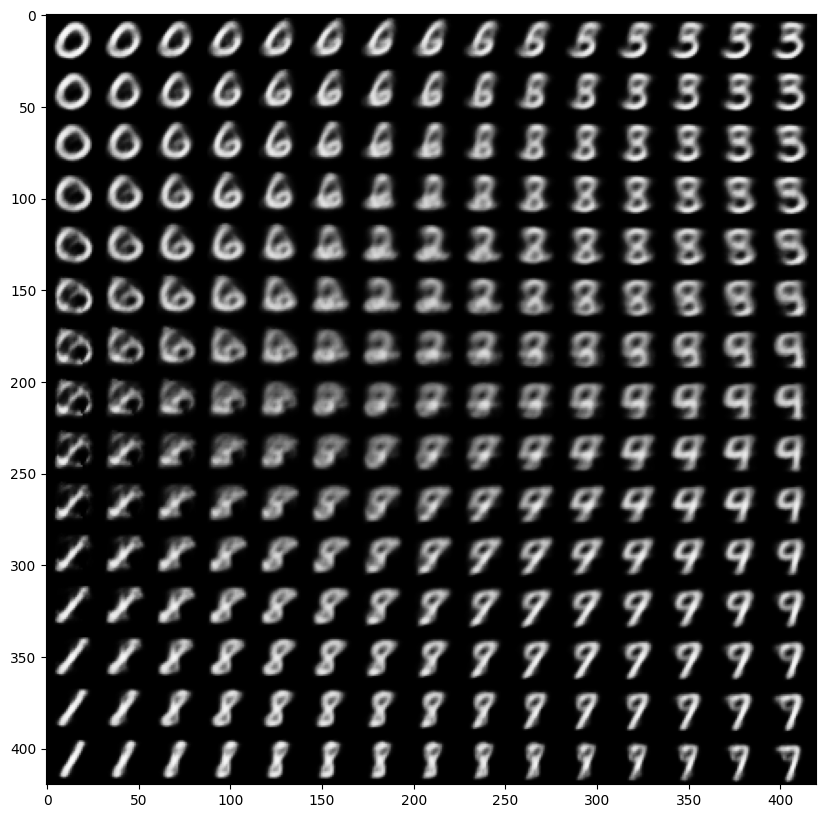

Train Epoch: 12 [0/60000 (0%)]	Loss: 164.448730
Train Epoch: 12 [10000/60000 (17%)]	Loss: 155.804961
Train Epoch: 12 [20000/60000 (33%)]	Loss: 159.034111
Train Epoch: 12 [30000/60000 (50%)]	Loss: 149.286035
Train Epoch: 12 [40000/60000 (67%)]	Loss: 149.406016
Train Epoch: 12 [50000/60000 (83%)]	Loss: 154.830879
====> Epoch: 12 Average loss: 155.2183
====> Test set loss: 155.3925


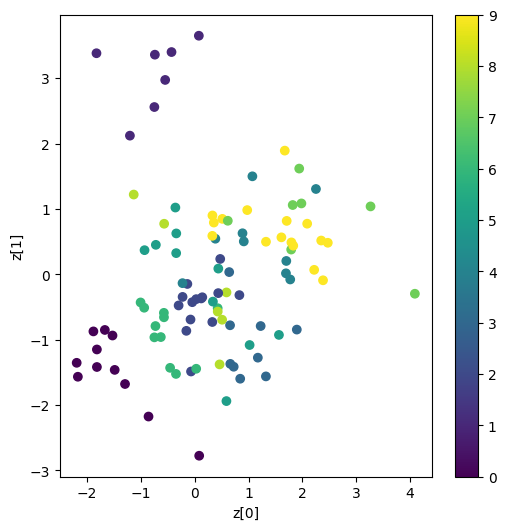

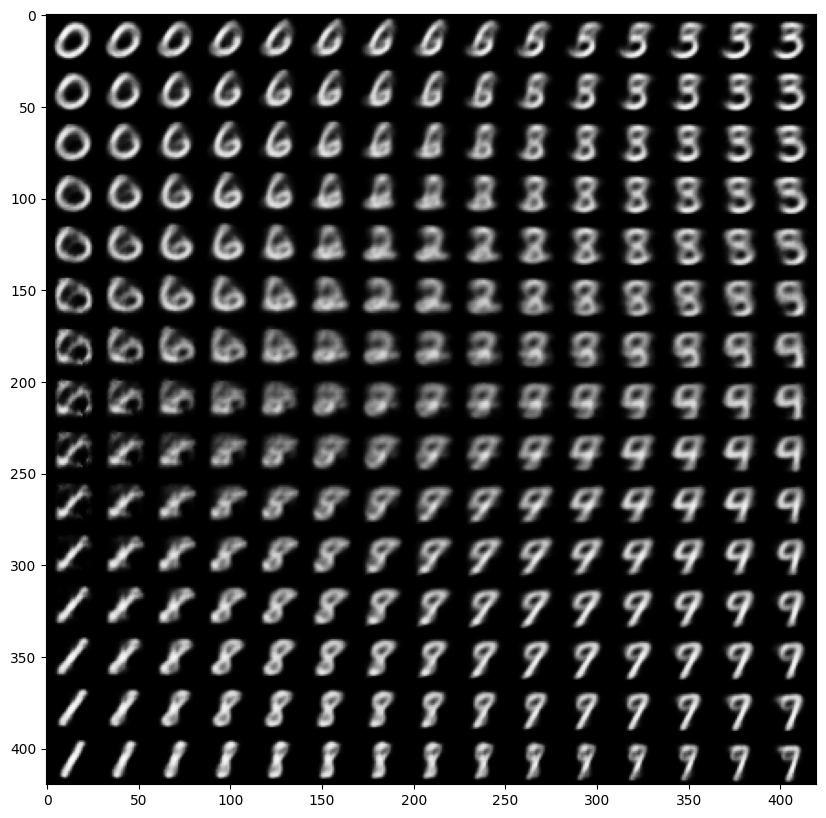

Train Epoch: 13 [0/60000 (0%)]	Loss: 151.654561
Train Epoch: 13 [10000/60000 (17%)]	Loss: 152.426475
Train Epoch: 13 [20000/60000 (33%)]	Loss: 151.517988
Train Epoch: 13 [30000/60000 (50%)]	Loss: 161.135459
Train Epoch: 13 [40000/60000 (67%)]	Loss: 160.434590
Train Epoch: 13 [50000/60000 (83%)]	Loss: 152.712842
====> Epoch: 13 Average loss: 154.7528
====> Test set loss: 154.7348


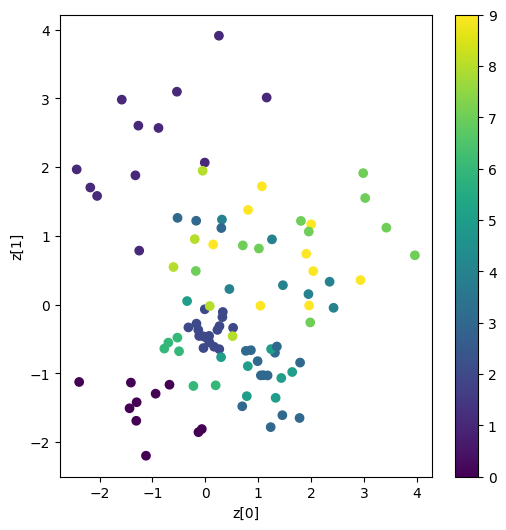

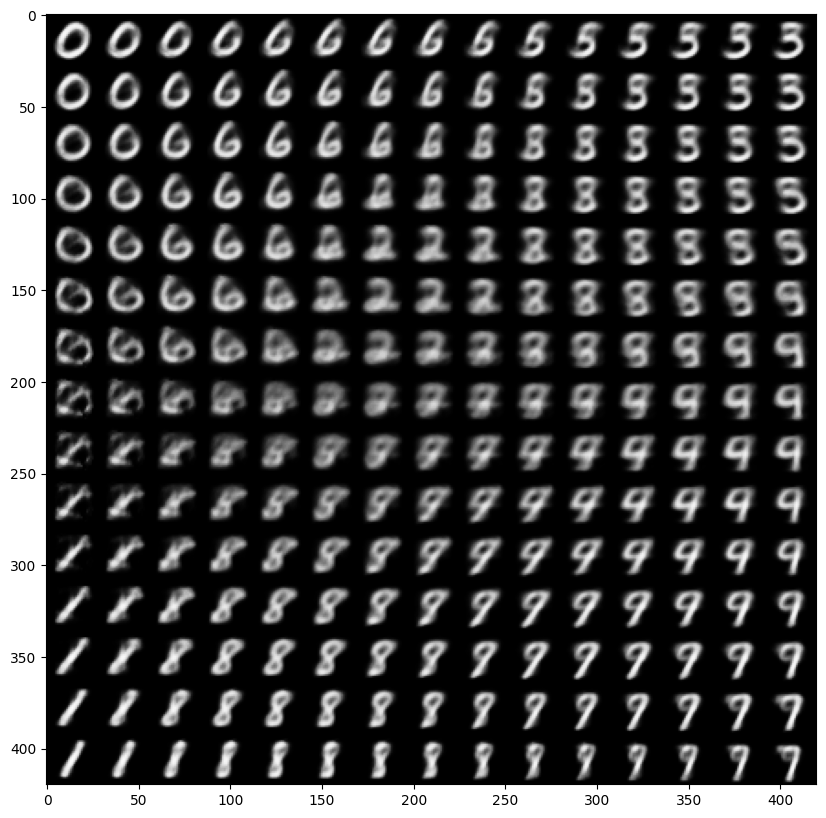

Train Epoch: 14 [0/60000 (0%)]	Loss: 161.008438
Train Epoch: 14 [10000/60000 (17%)]	Loss: 161.592041
Train Epoch: 14 [20000/60000 (33%)]	Loss: 162.435771
Train Epoch: 14 [30000/60000 (50%)]	Loss: 156.401357
Train Epoch: 14 [40000/60000 (67%)]	Loss: 158.600586
Train Epoch: 14 [50000/60000 (83%)]	Loss: 164.545449
====> Epoch: 14 Average loss: 154.2720
====> Test set loss: 154.4905


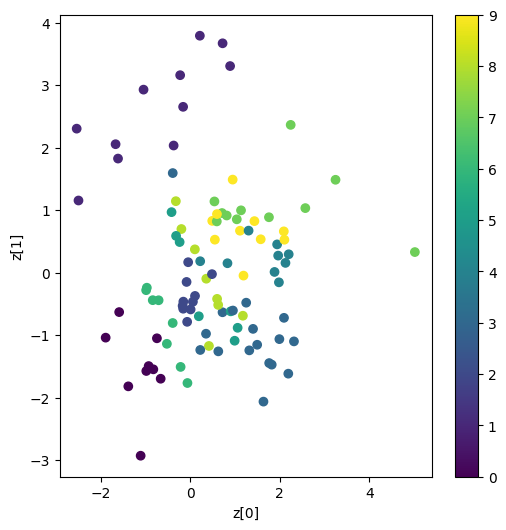

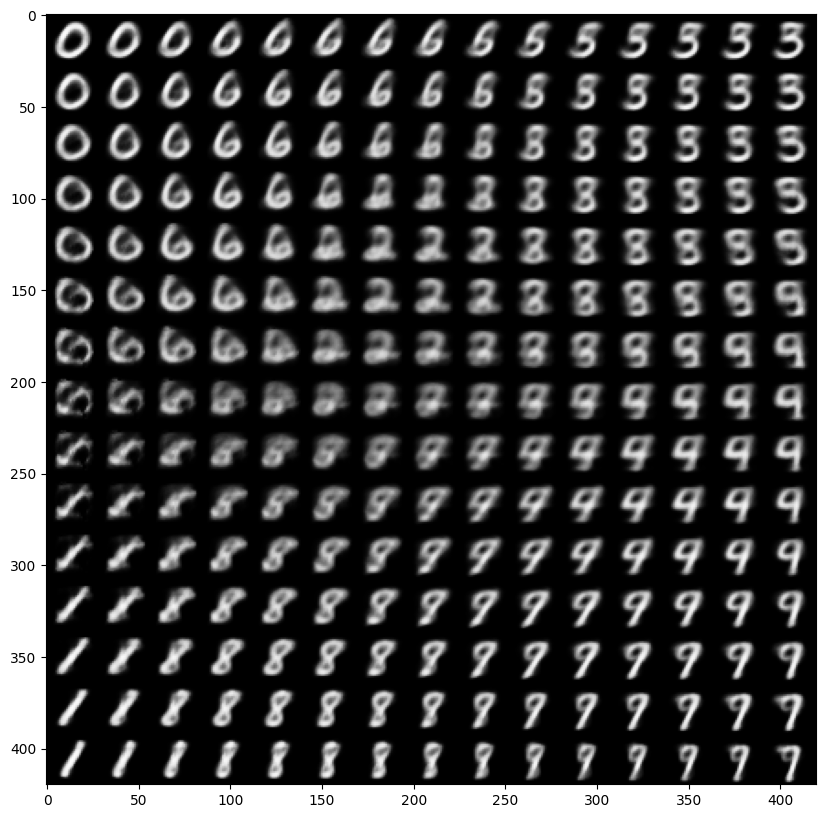

Train Epoch: 15 [0/60000 (0%)]	Loss: 157.043916
Train Epoch: 15 [10000/60000 (17%)]	Loss: 151.212109
Train Epoch: 15 [20000/60000 (33%)]	Loss: 150.911992
Train Epoch: 15 [30000/60000 (50%)]	Loss: 152.692988
Train Epoch: 15 [40000/60000 (67%)]	Loss: 162.206680
Train Epoch: 15 [50000/60000 (83%)]	Loss: 158.396191
====> Epoch: 15 Average loss: 153.7718
====> Test set loss: 154.1543


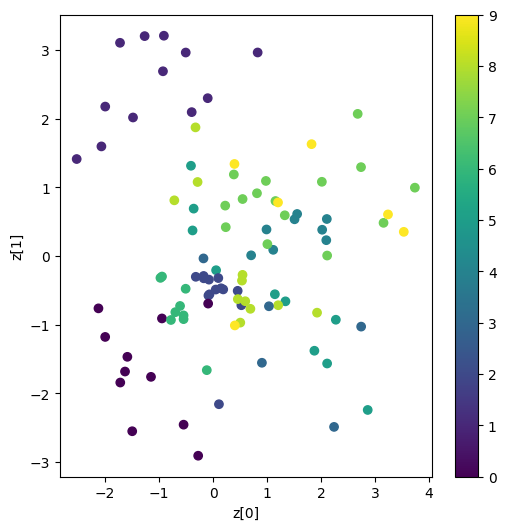

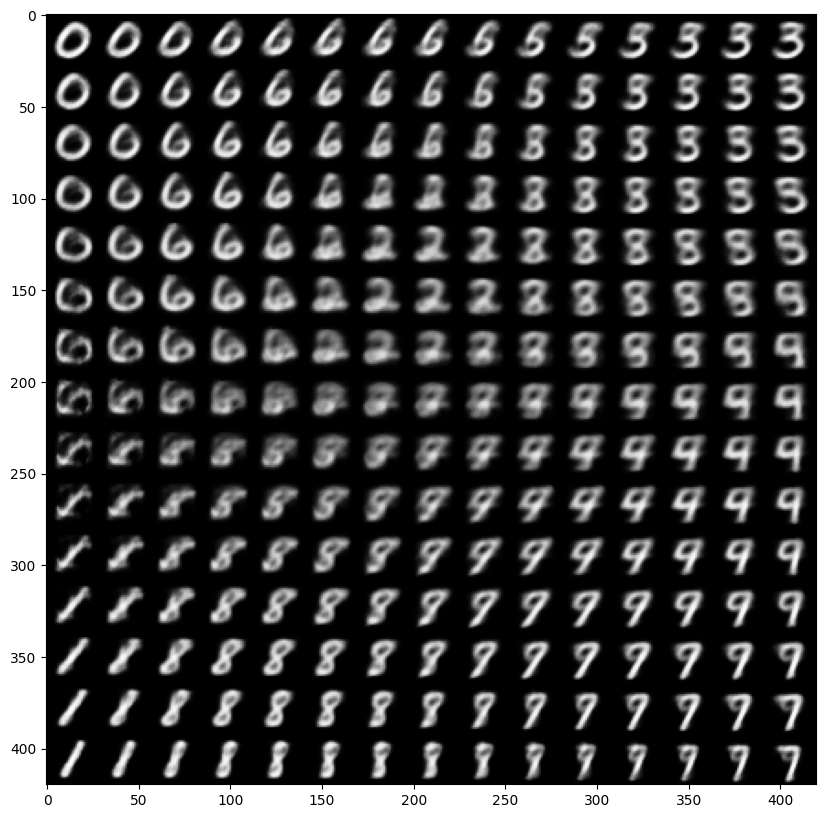

Train Epoch: 16 [0/60000 (0%)]	Loss: 154.891260
Train Epoch: 16 [10000/60000 (17%)]	Loss: 155.560029
Train Epoch: 16 [20000/60000 (33%)]	Loss: 162.263662
Train Epoch: 16 [30000/60000 (50%)]	Loss: 149.835645
Train Epoch: 16 [40000/60000 (67%)]	Loss: 162.820000
Train Epoch: 16 [50000/60000 (83%)]	Loss: 150.781582
====> Epoch: 16 Average loss: 153.4057
====> Test set loss: 153.7756


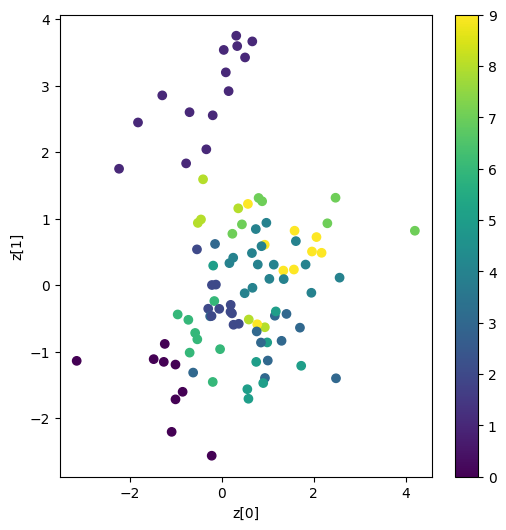

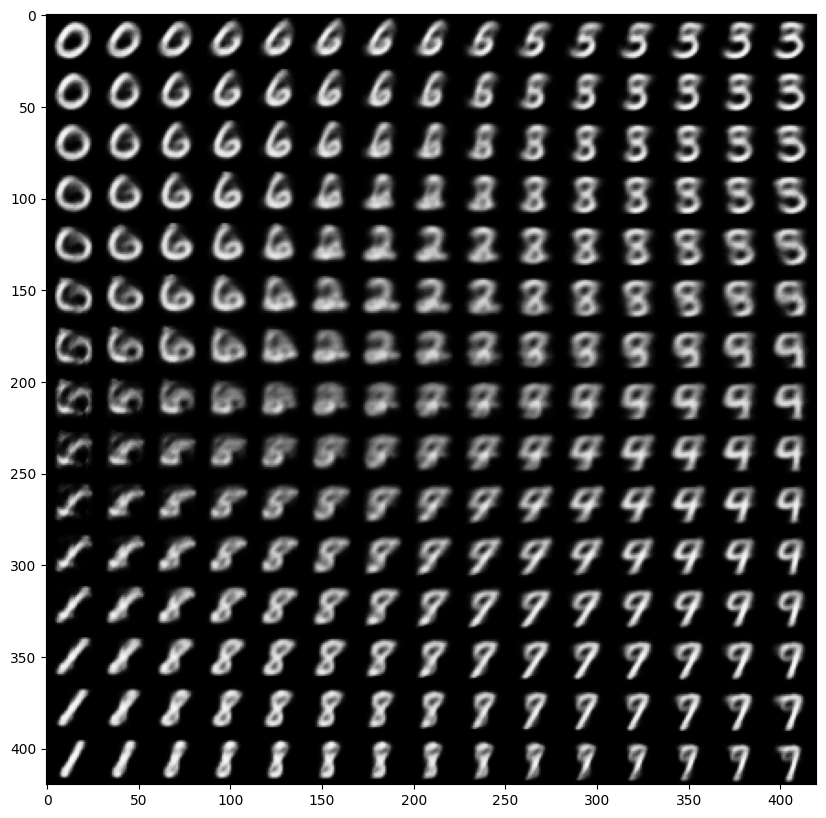

Train Epoch: 17 [0/60000 (0%)]	Loss: 148.026133
Train Epoch: 17 [10000/60000 (17%)]	Loss: 152.978076
Train Epoch: 17 [20000/60000 (33%)]	Loss: 159.702480
Train Epoch: 17 [30000/60000 (50%)]	Loss: 151.230713
Train Epoch: 17 [40000/60000 (67%)]	Loss: 147.916602
Train Epoch: 17 [50000/60000 (83%)]	Loss: 159.723008
====> Epoch: 17 Average loss: 153.0559
====> Test set loss: 153.6869


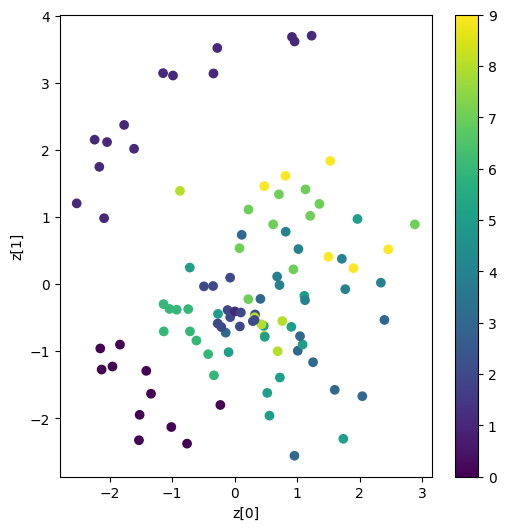

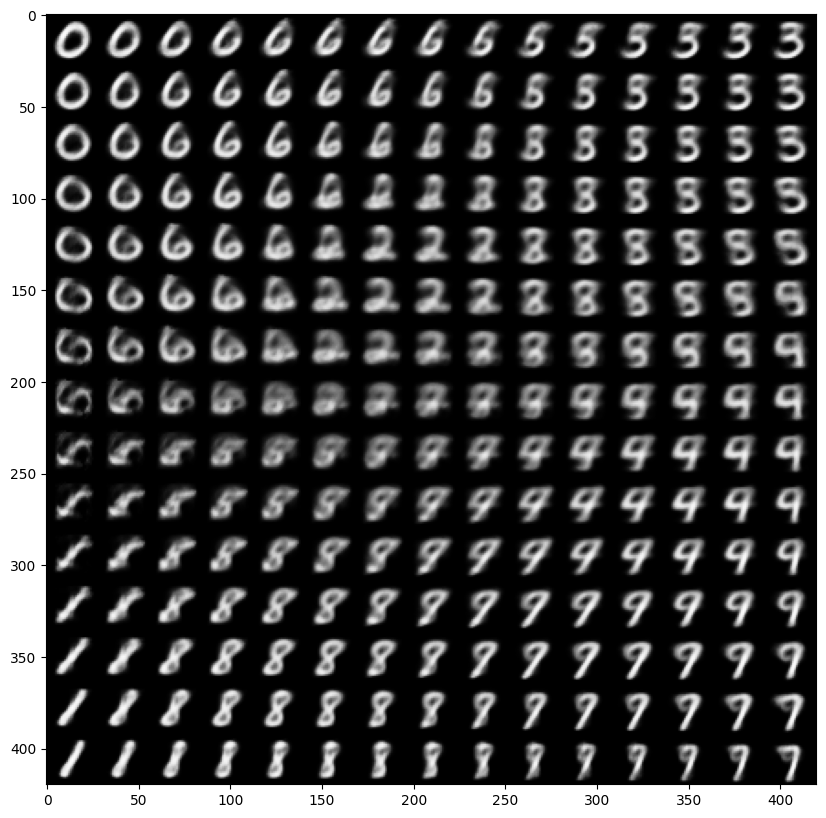

Train Epoch: 18 [0/60000 (0%)]	Loss: 153.376709
Train Epoch: 18 [10000/60000 (17%)]	Loss: 157.849951
Train Epoch: 18 [20000/60000 (33%)]	Loss: 156.770391
Train Epoch: 18 [30000/60000 (50%)]	Loss: 144.711992
Train Epoch: 18 [40000/60000 (67%)]	Loss: 152.151475
Train Epoch: 18 [50000/60000 (83%)]	Loss: 159.636758
====> Epoch: 18 Average loss: 152.6648
====> Test set loss: 153.3220


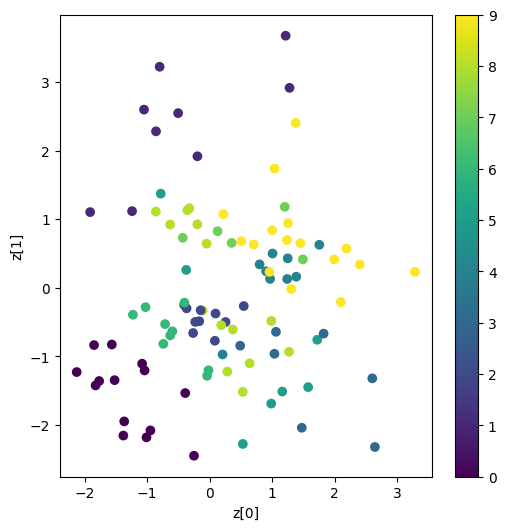

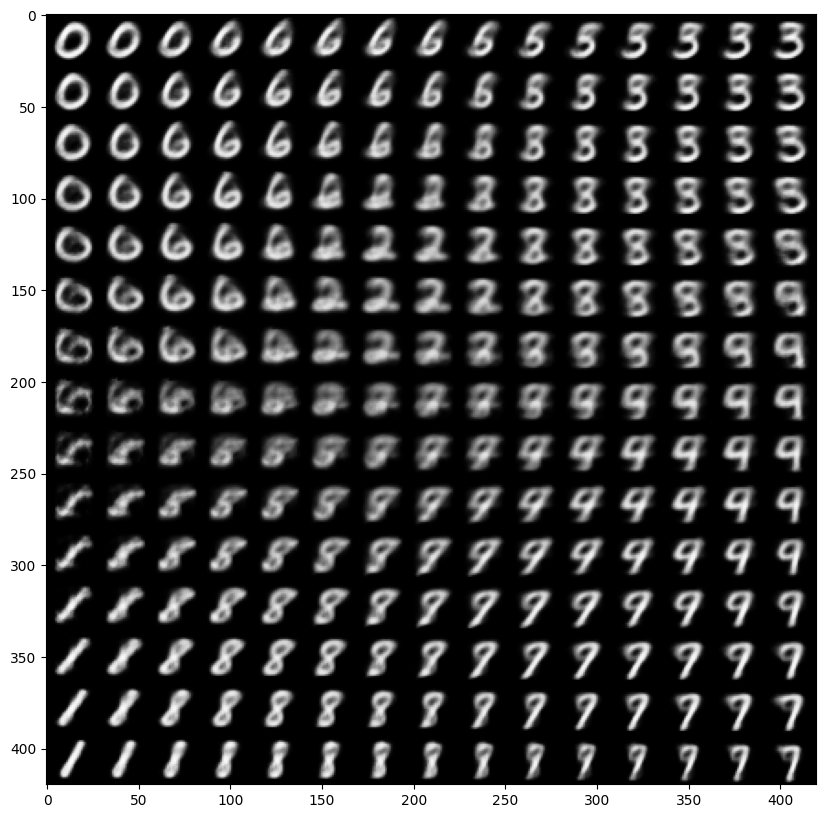

Train Epoch: 19 [0/60000 (0%)]	Loss: 151.526953
Train Epoch: 19 [10000/60000 (17%)]	Loss: 158.131777
Train Epoch: 19 [20000/60000 (33%)]	Loss: 157.589121
Train Epoch: 19 [30000/60000 (50%)]	Loss: 152.831367
Train Epoch: 19 [40000/60000 (67%)]	Loss: 148.341885
Train Epoch: 19 [50000/60000 (83%)]	Loss: 148.794678
====> Epoch: 19 Average loss: 152.3682
====> Test set loss: 153.2203


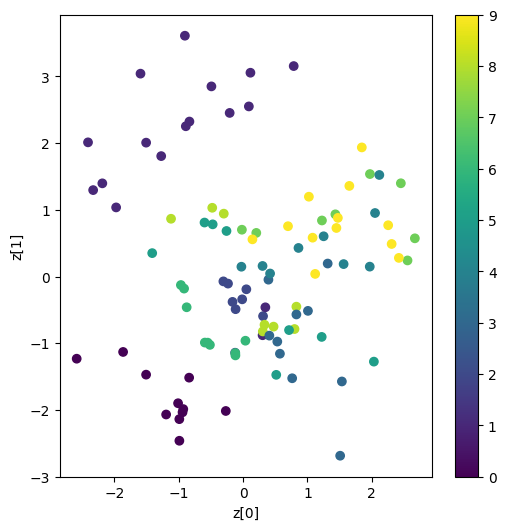

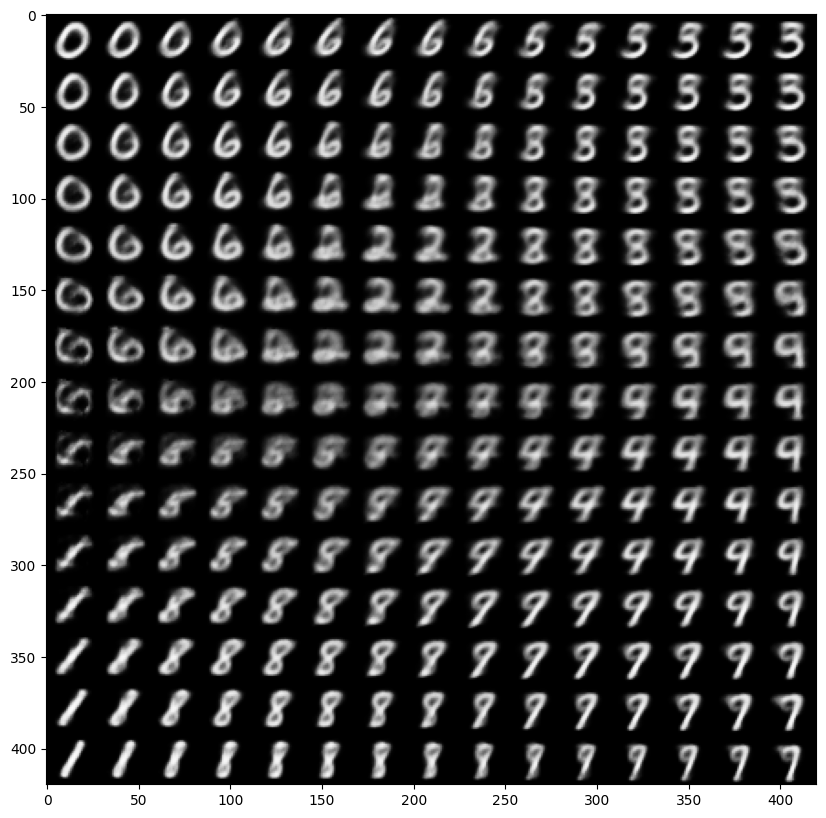

Train Epoch: 20 [0/60000 (0%)]	Loss: 151.169365
Train Epoch: 20 [10000/60000 (17%)]	Loss: 151.569766
Train Epoch: 20 [20000/60000 (33%)]	Loss: 150.702080
Train Epoch: 20 [30000/60000 (50%)]	Loss: 157.790859
Train Epoch: 20 [40000/60000 (67%)]	Loss: 157.962939
Train Epoch: 20 [50000/60000 (83%)]	Loss: 155.959893
====> Epoch: 20 Average loss: 152.0687
====> Test set loss: 153.1158


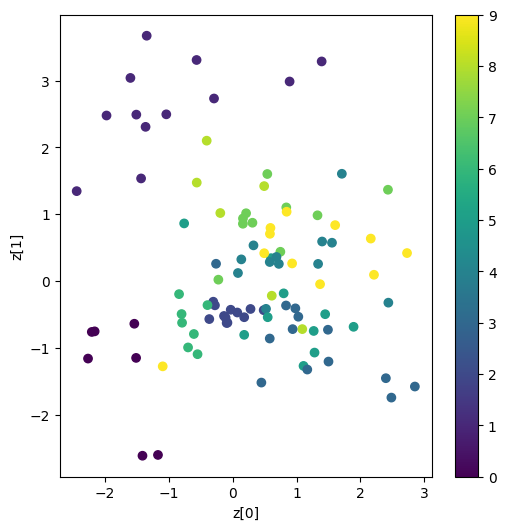

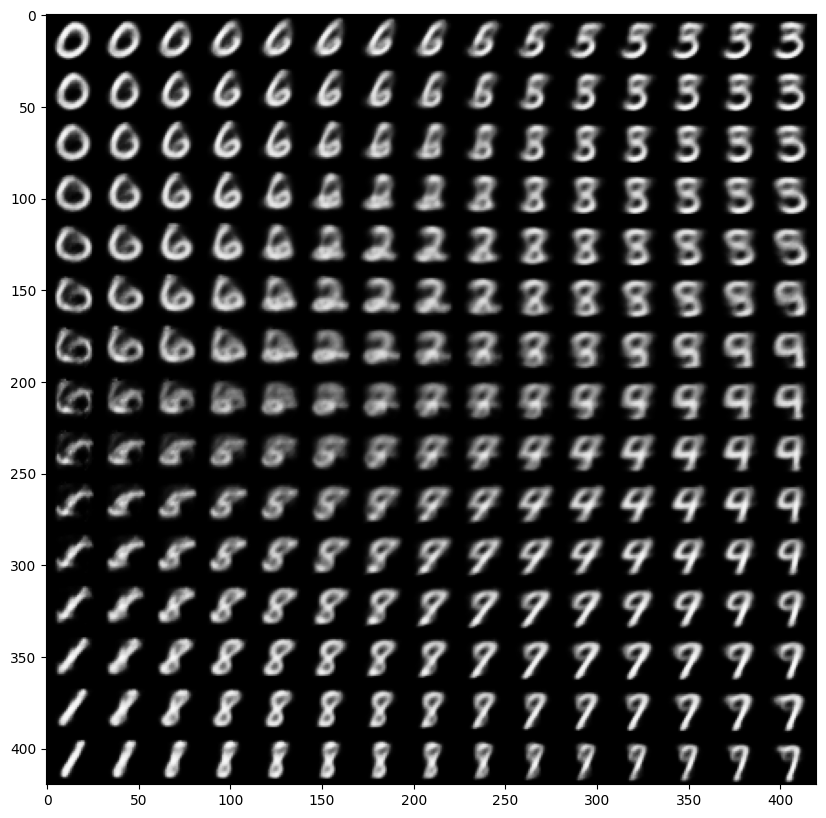

Train Epoch: 21 [0/60000 (0%)]	Loss: 147.734424
Train Epoch: 21 [10000/60000 (17%)]	Loss: 158.882393
Train Epoch: 21 [20000/60000 (33%)]	Loss: 145.399746
Train Epoch: 21 [30000/60000 (50%)]	Loss: 147.562070
Train Epoch: 21 [40000/60000 (67%)]	Loss: 150.089453
Train Epoch: 21 [50000/60000 (83%)]	Loss: 154.556348
====> Epoch: 21 Average loss: 151.7503
====> Test set loss: 152.6161


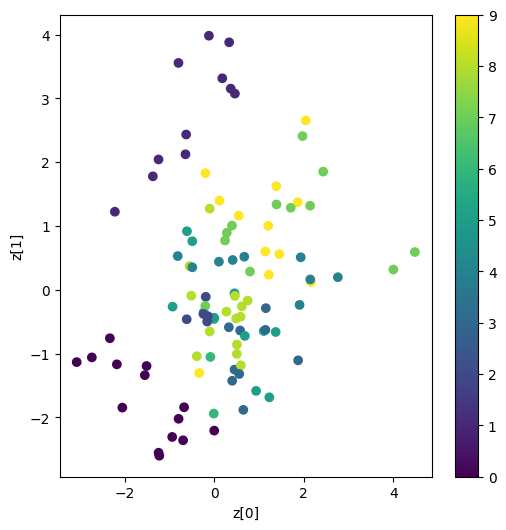

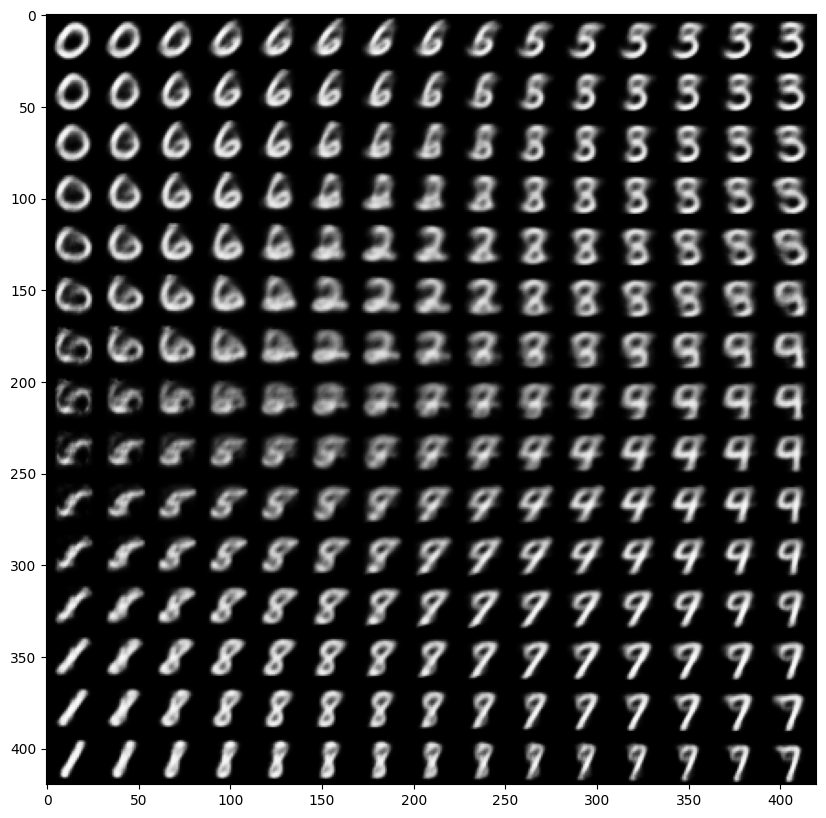

Train Epoch: 22 [0/60000 (0%)]	Loss: 159.732188
Train Epoch: 22 [10000/60000 (17%)]	Loss: 157.645674
Train Epoch: 22 [20000/60000 (33%)]	Loss: 146.323574
Train Epoch: 22 [30000/60000 (50%)]	Loss: 150.393340
Train Epoch: 22 [40000/60000 (67%)]	Loss: 154.659141
Train Epoch: 22 [50000/60000 (83%)]	Loss: 147.360762
====> Epoch: 22 Average loss: 151.4859
====> Test set loss: 152.3905


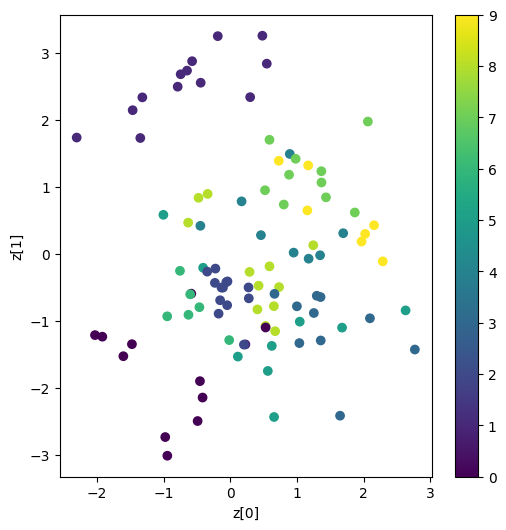

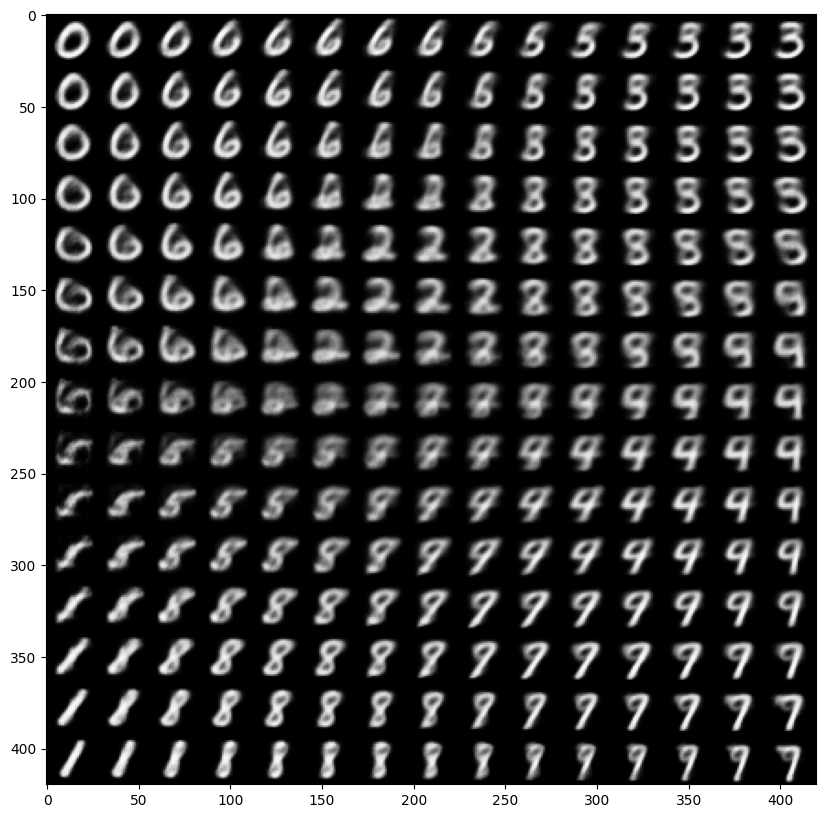

Train Epoch: 23 [0/60000 (0%)]	Loss: 151.630098
Train Epoch: 23 [10000/60000 (17%)]	Loss: 151.742764
Train Epoch: 23 [20000/60000 (33%)]	Loss: 157.804531
Train Epoch: 23 [30000/60000 (50%)]	Loss: 152.607637
Train Epoch: 23 [40000/60000 (67%)]	Loss: 147.568018
Train Epoch: 23 [50000/60000 (83%)]	Loss: 145.862021
====> Epoch: 23 Average loss: 151.2454
====> Test set loss: 152.2378


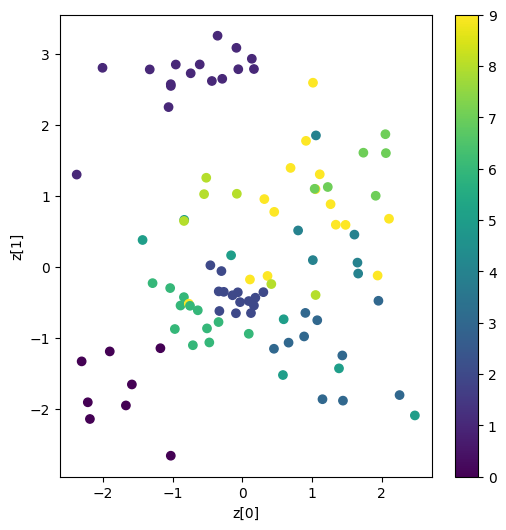

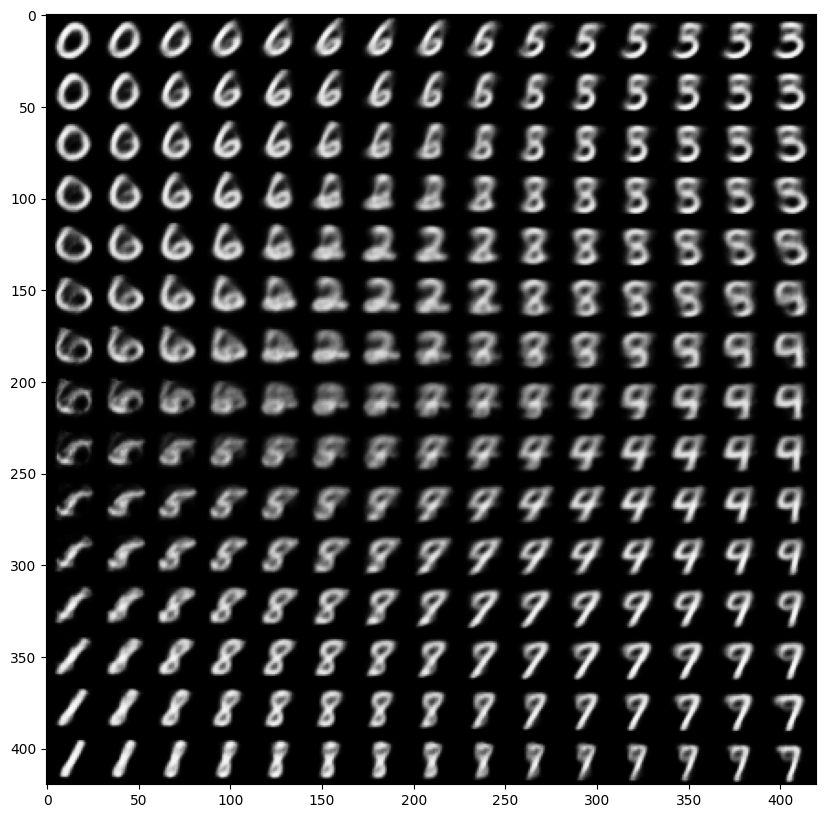

Train Epoch: 24 [0/60000 (0%)]	Loss: 148.742510
Train Epoch: 24 [10000/60000 (17%)]	Loss: 143.465430
Train Epoch: 24 [20000/60000 (33%)]	Loss: 145.085332
Train Epoch: 24 [30000/60000 (50%)]	Loss: 153.075693
Train Epoch: 24 [40000/60000 (67%)]	Loss: 159.381289
Train Epoch: 24 [50000/60000 (83%)]	Loss: 151.683535
====> Epoch: 24 Average loss: 151.0040
====> Test set loss: 152.3024


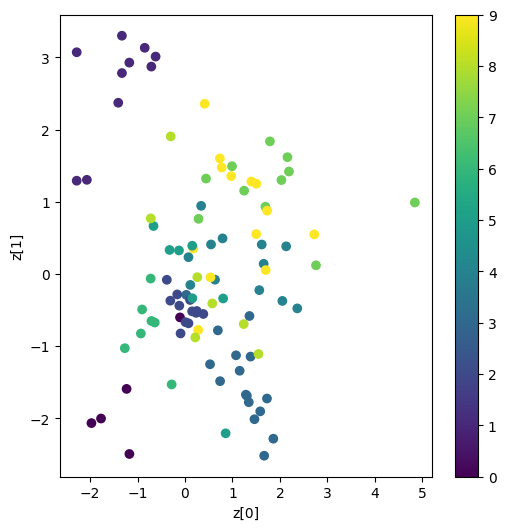

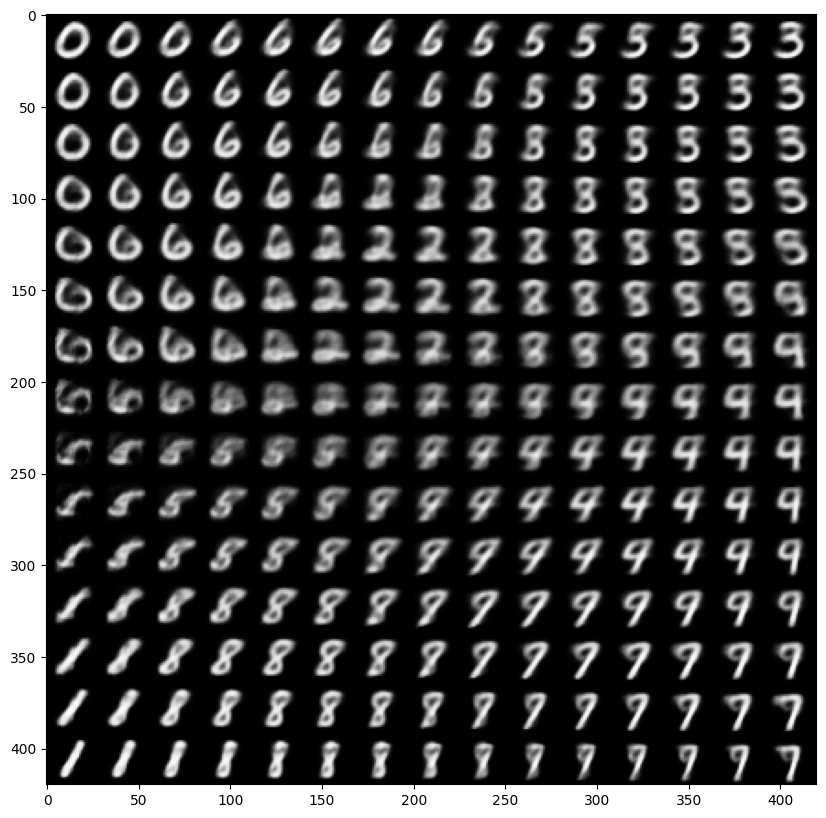

Train Epoch: 25 [0/60000 (0%)]	Loss: 150.172832
Train Epoch: 25 [10000/60000 (17%)]	Loss: 154.260068
Train Epoch: 25 [20000/60000 (33%)]	Loss: 154.320889
Train Epoch: 25 [30000/60000 (50%)]	Loss: 153.073066
Train Epoch: 25 [40000/60000 (67%)]	Loss: 144.681738
Train Epoch: 25 [50000/60000 (83%)]	Loss: 151.107051
====> Epoch: 25 Average loss: 150.8177
====> Test set loss: 152.1589


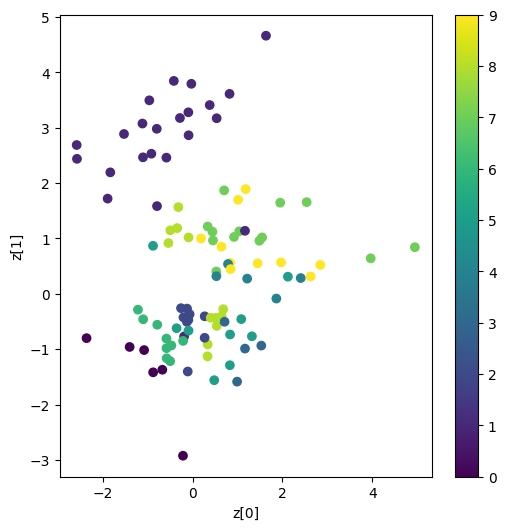

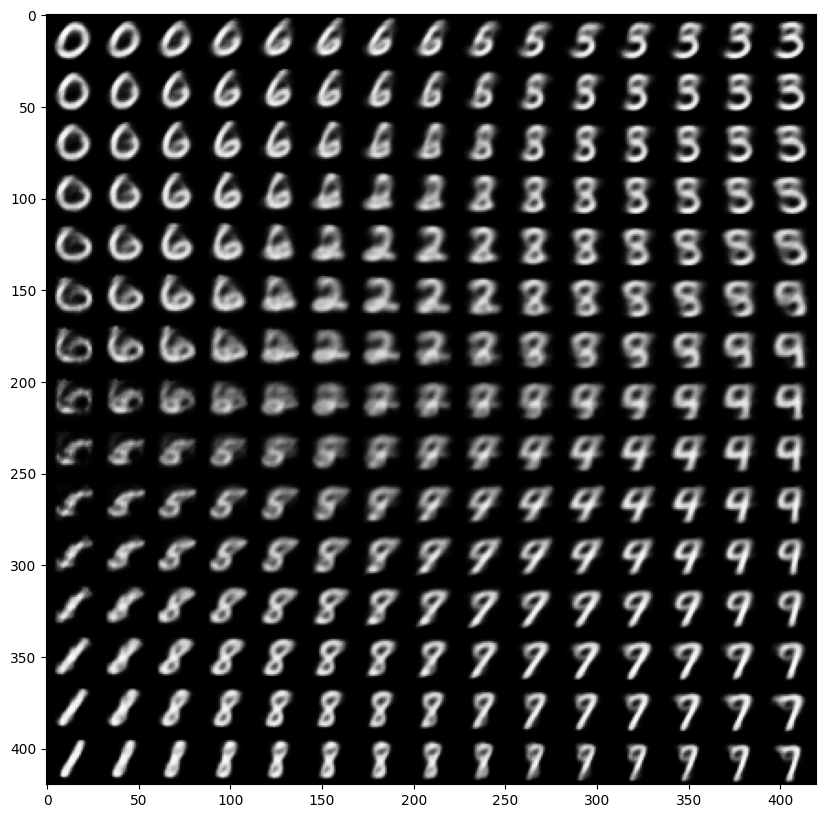

Train Epoch: 26 [0/60000 (0%)]	Loss: 151.522822
Train Epoch: 26 [10000/60000 (17%)]	Loss: 142.415186
Train Epoch: 26 [20000/60000 (33%)]	Loss: 149.669229
Train Epoch: 26 [30000/60000 (50%)]	Loss: 150.866660
Train Epoch: 26 [40000/60000 (67%)]	Loss: 157.350723
Train Epoch: 26 [50000/60000 (83%)]	Loss: 149.577041
====> Epoch: 26 Average loss: 150.6061
====> Test set loss: 151.8864


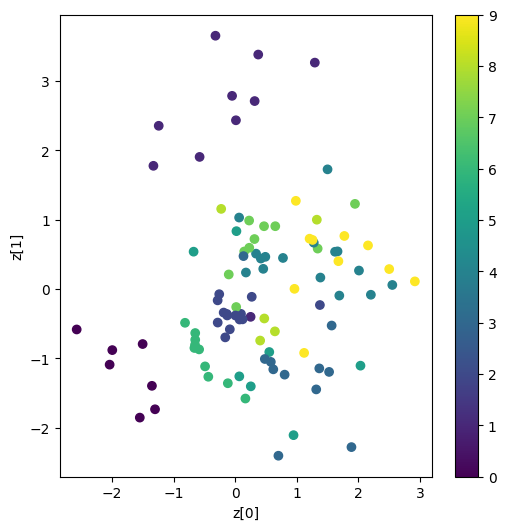

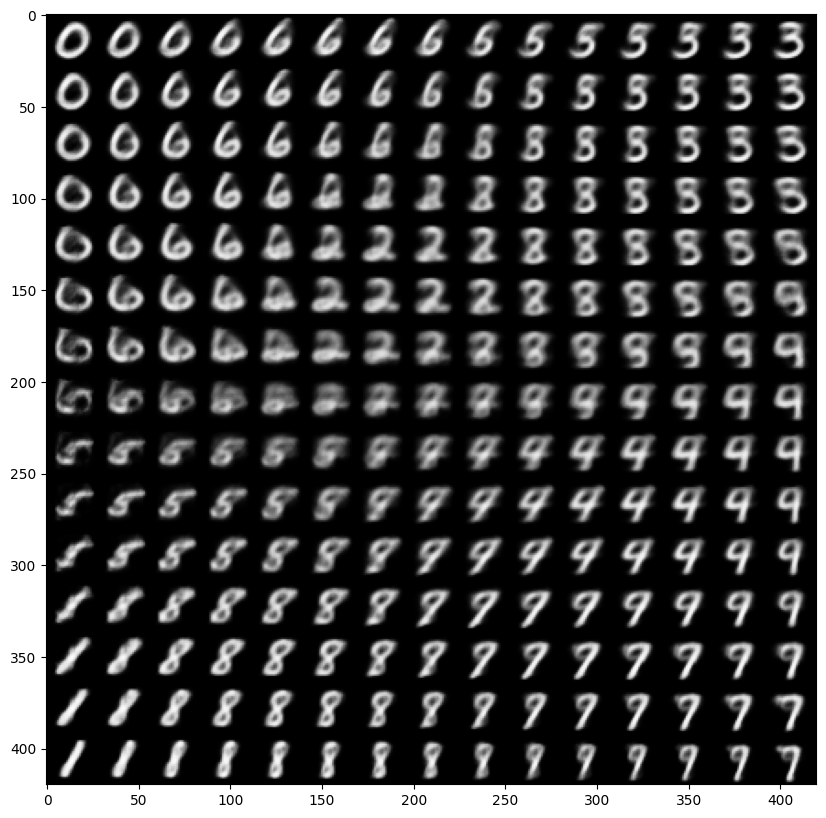

Train Epoch: 27 [0/60000 (0%)]	Loss: 144.487383
Train Epoch: 27 [10000/60000 (17%)]	Loss: 148.491465
Train Epoch: 27 [20000/60000 (33%)]	Loss: 145.632090
Train Epoch: 27 [30000/60000 (50%)]	Loss: 149.055029
Train Epoch: 27 [40000/60000 (67%)]	Loss: 154.840547
Train Epoch: 27 [50000/60000 (83%)]	Loss: 141.318125
====> Epoch: 27 Average loss: 150.3559
====> Test set loss: 151.9113


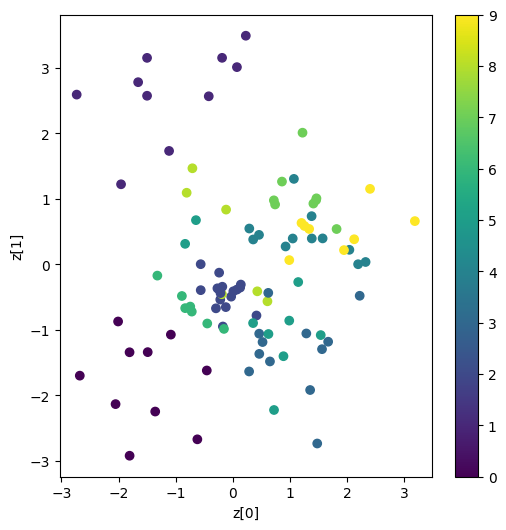

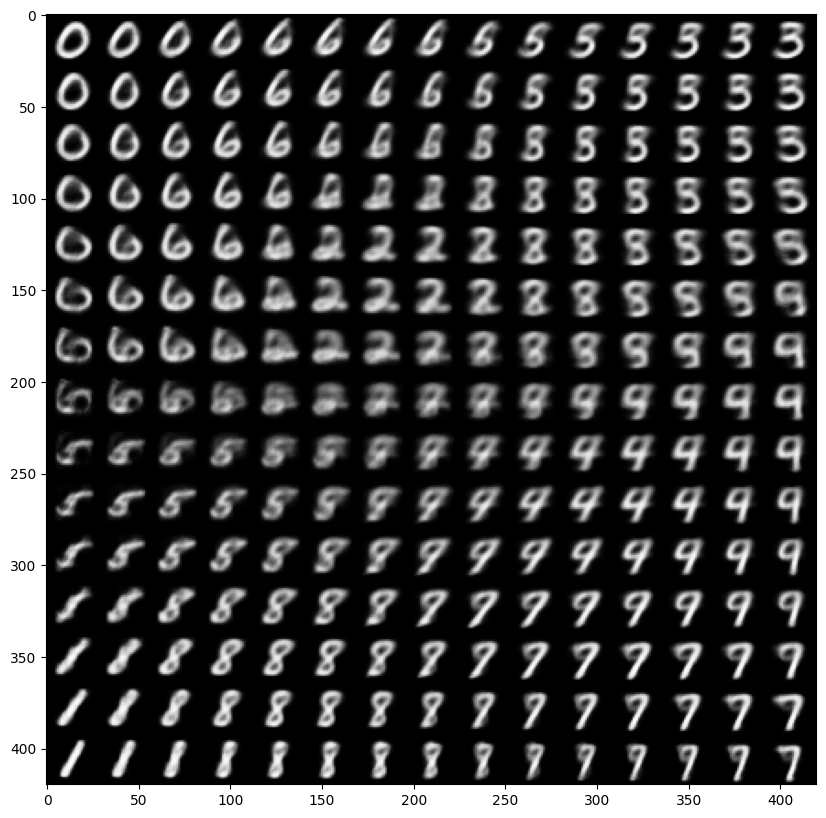

Train Epoch: 28 [0/60000 (0%)]	Loss: 150.704844
Train Epoch: 28 [10000/60000 (17%)]	Loss: 148.162021
Train Epoch: 28 [20000/60000 (33%)]	Loss: 153.063389
Train Epoch: 28 [30000/60000 (50%)]	Loss: 152.863584
Train Epoch: 28 [40000/60000 (67%)]	Loss: 148.709365
Train Epoch: 28 [50000/60000 (83%)]	Loss: 149.314521
====> Epoch: 28 Average loss: 150.1340
====> Test set loss: 151.6840


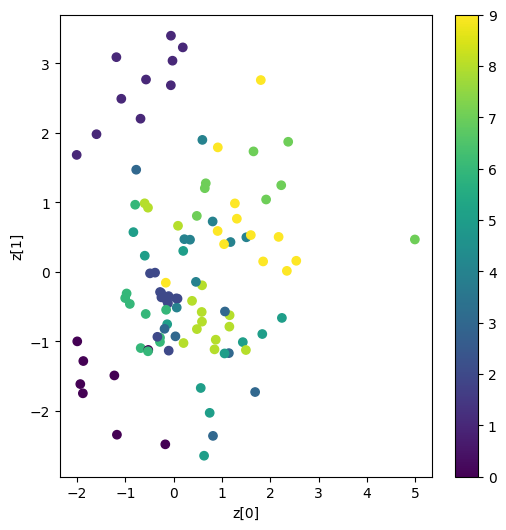

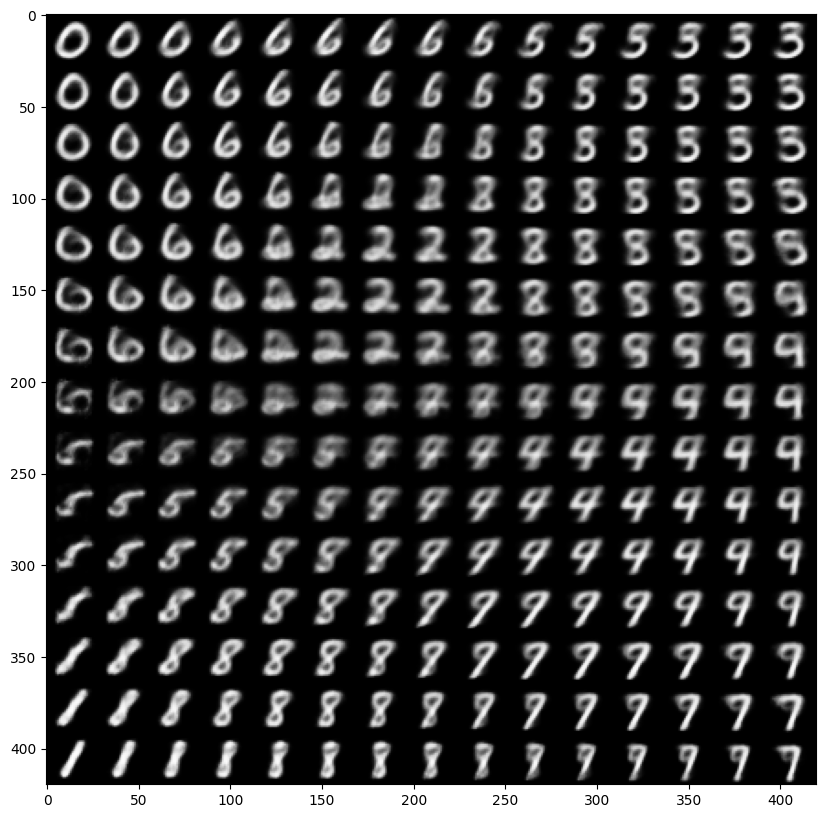

Train Epoch: 29 [0/60000 (0%)]	Loss: 150.312813
Train Epoch: 29 [10000/60000 (17%)]	Loss: 146.656084
Train Epoch: 29 [20000/60000 (33%)]	Loss: 153.940937
Train Epoch: 29 [30000/60000 (50%)]	Loss: 154.771738
Train Epoch: 29 [40000/60000 (67%)]	Loss: 148.998418
Train Epoch: 29 [50000/60000 (83%)]	Loss: 151.403359
====> Epoch: 29 Average loss: 150.0130
====> Test set loss: 151.4855


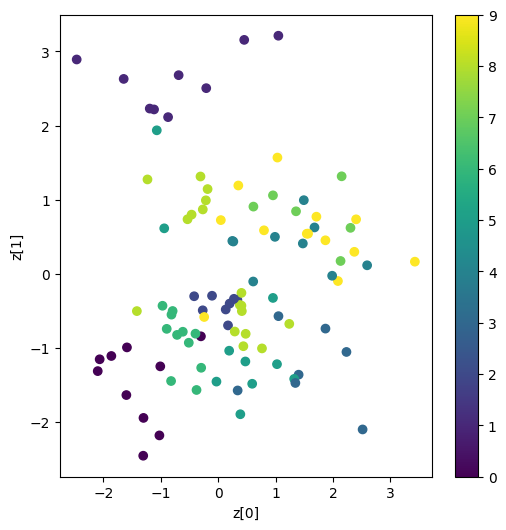

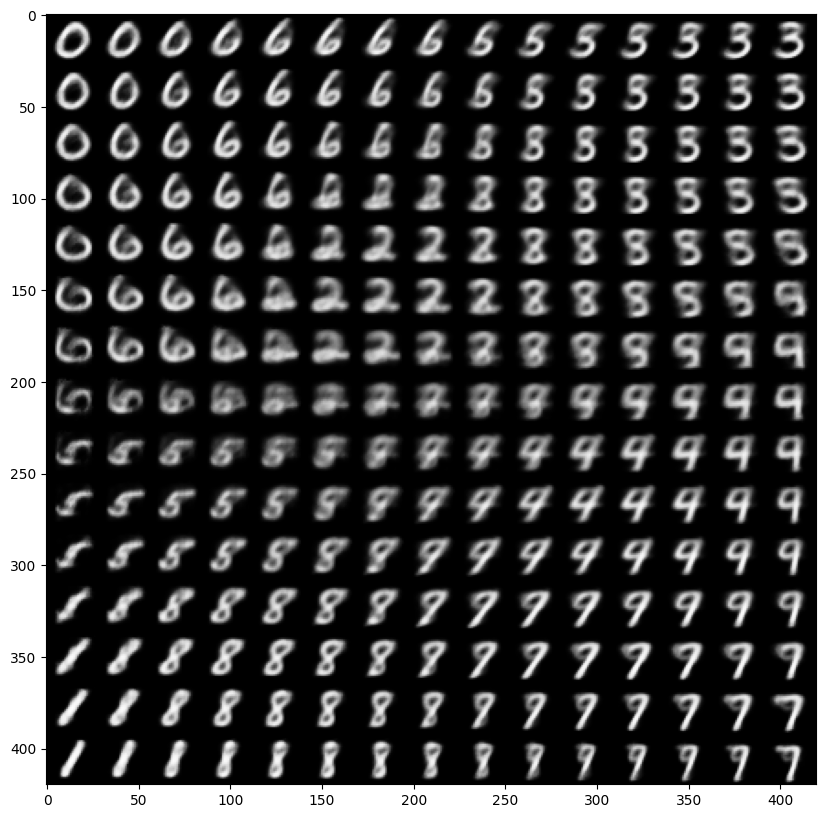

Train Epoch: 30 [0/60000 (0%)]	Loss: 153.235928
Train Epoch: 30 [10000/60000 (17%)]	Loss: 156.650811
Train Epoch: 30 [20000/60000 (33%)]	Loss: 145.947305
Train Epoch: 30 [30000/60000 (50%)]	Loss: 150.248662
Train Epoch: 30 [40000/60000 (67%)]	Loss: 152.262891
Train Epoch: 30 [50000/60000 (83%)]	Loss: 153.249854
====> Epoch: 30 Average loss: 149.7613
====> Test set loss: 151.7877


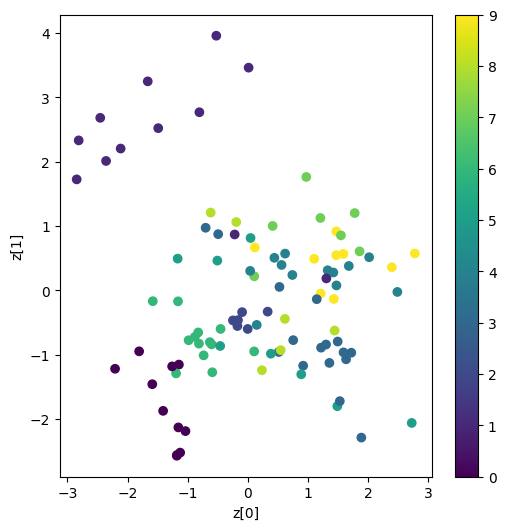

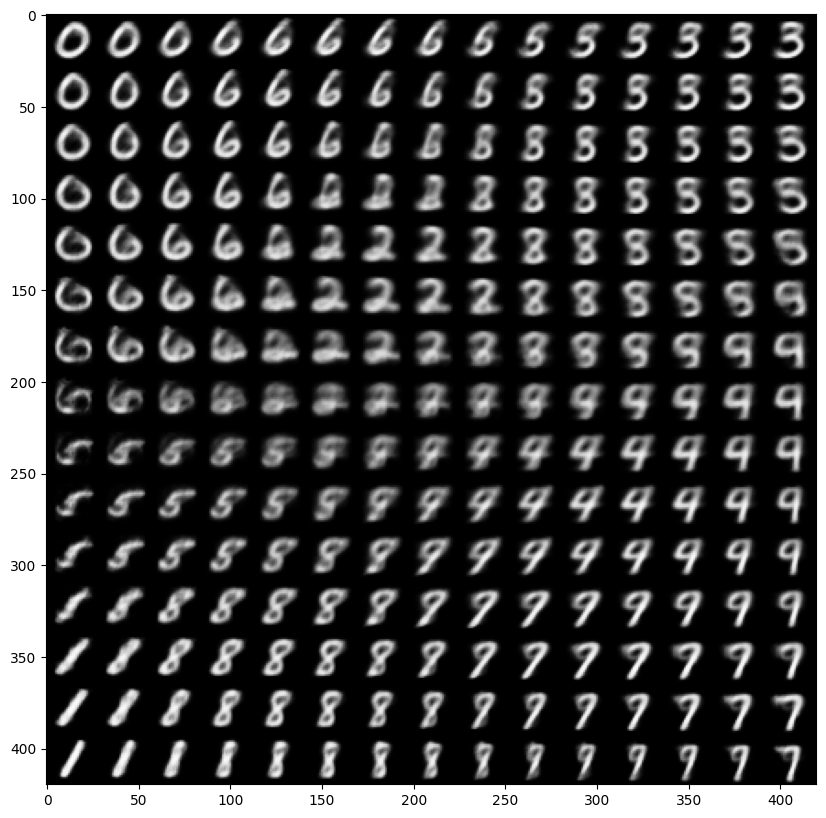

Train Epoch: 31 [0/60000 (0%)]	Loss: 151.784258
Train Epoch: 31 [10000/60000 (17%)]	Loss: 145.520371
Train Epoch: 31 [20000/60000 (33%)]	Loss: 143.347500
Train Epoch: 31 [30000/60000 (50%)]	Loss: 148.903594
Train Epoch: 31 [40000/60000 (67%)]	Loss: 152.400166
Train Epoch: 31 [50000/60000 (83%)]	Loss: 157.871133
====> Epoch: 31 Average loss: 149.6490
====> Test set loss: 151.4299


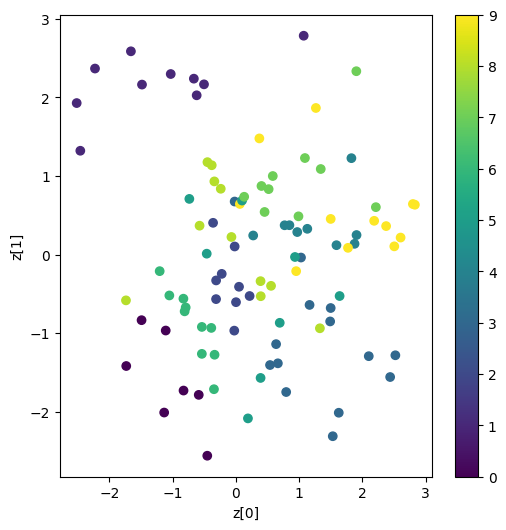

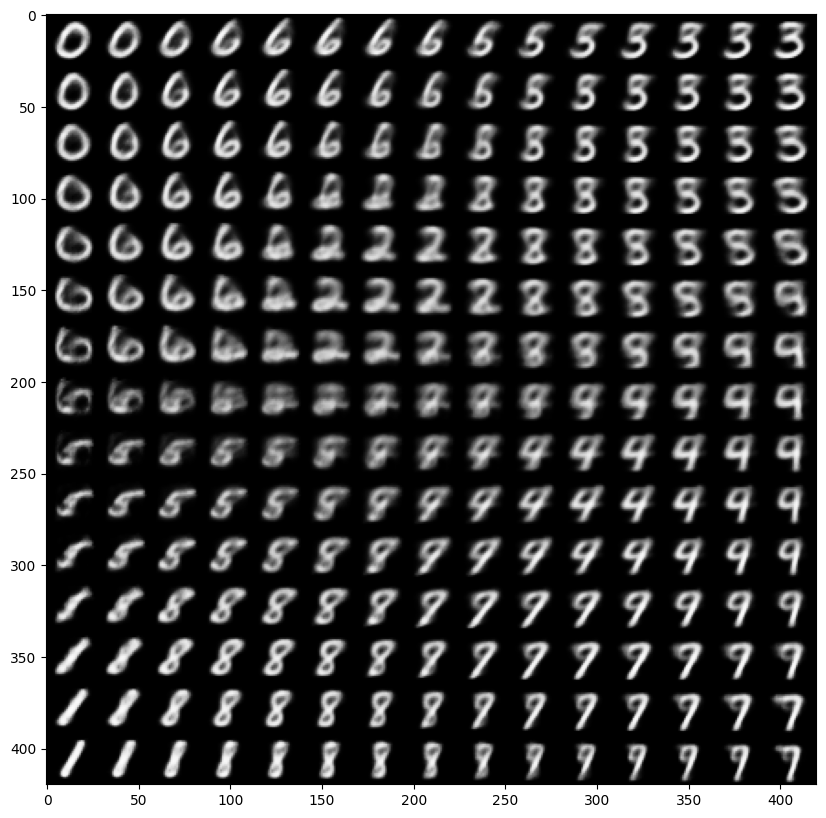

Train Epoch: 32 [0/60000 (0%)]	Loss: 153.144473
Train Epoch: 32 [10000/60000 (17%)]	Loss: 149.739014
Train Epoch: 32 [20000/60000 (33%)]	Loss: 148.175469
Train Epoch: 32 [30000/60000 (50%)]	Loss: 145.019512
Train Epoch: 32 [40000/60000 (67%)]	Loss: 148.614766
Train Epoch: 32 [50000/60000 (83%)]	Loss: 143.994434
====> Epoch: 32 Average loss: 149.4589
====> Test set loss: 151.3055


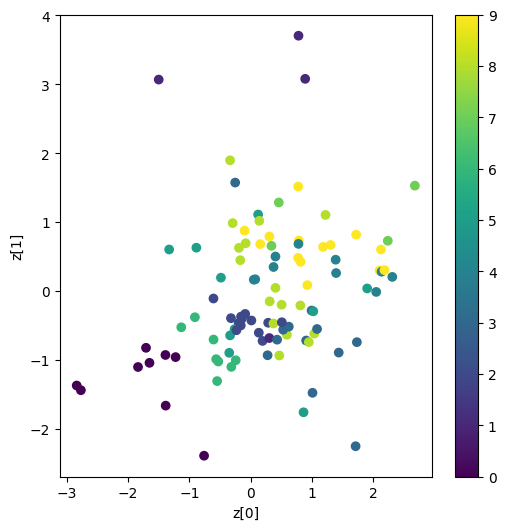

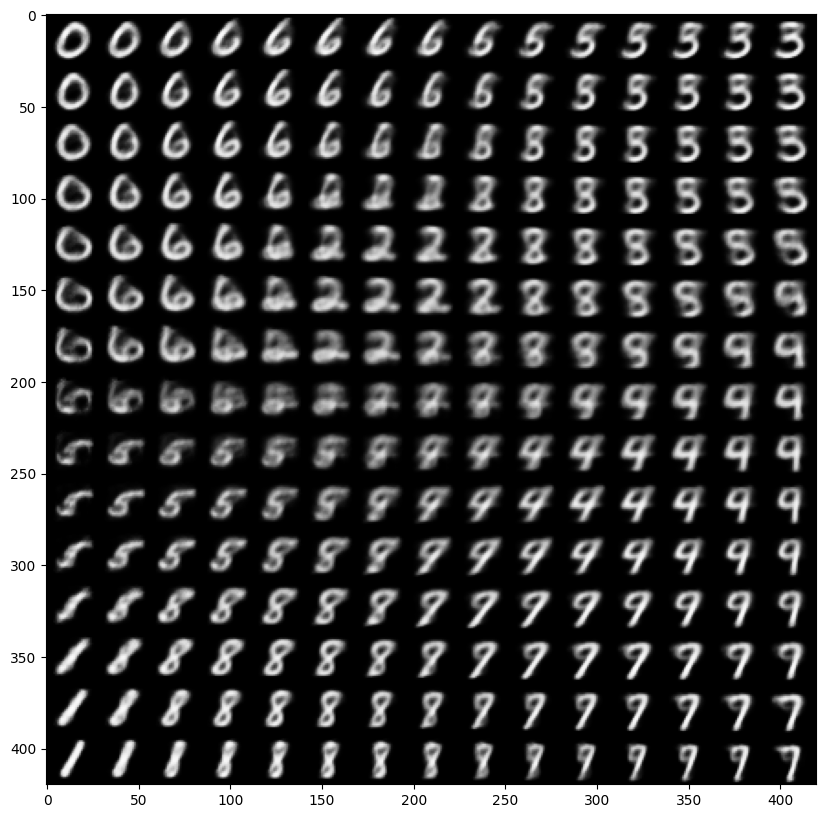

Train Epoch: 33 [0/60000 (0%)]	Loss: 151.838750
Train Epoch: 33 [10000/60000 (17%)]	Loss: 149.425000
Train Epoch: 33 [20000/60000 (33%)]	Loss: 148.314697
Train Epoch: 33 [30000/60000 (50%)]	Loss: 154.267383
Train Epoch: 33 [40000/60000 (67%)]	Loss: 139.572705
Train Epoch: 33 [50000/60000 (83%)]	Loss: 148.319648
====> Epoch: 33 Average loss: 149.2643
====> Test set loss: 152.0765


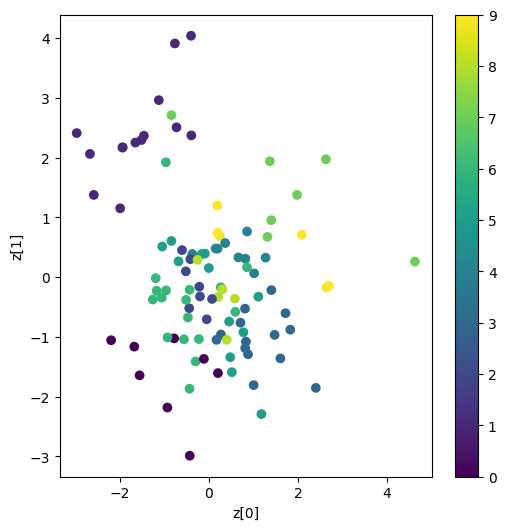

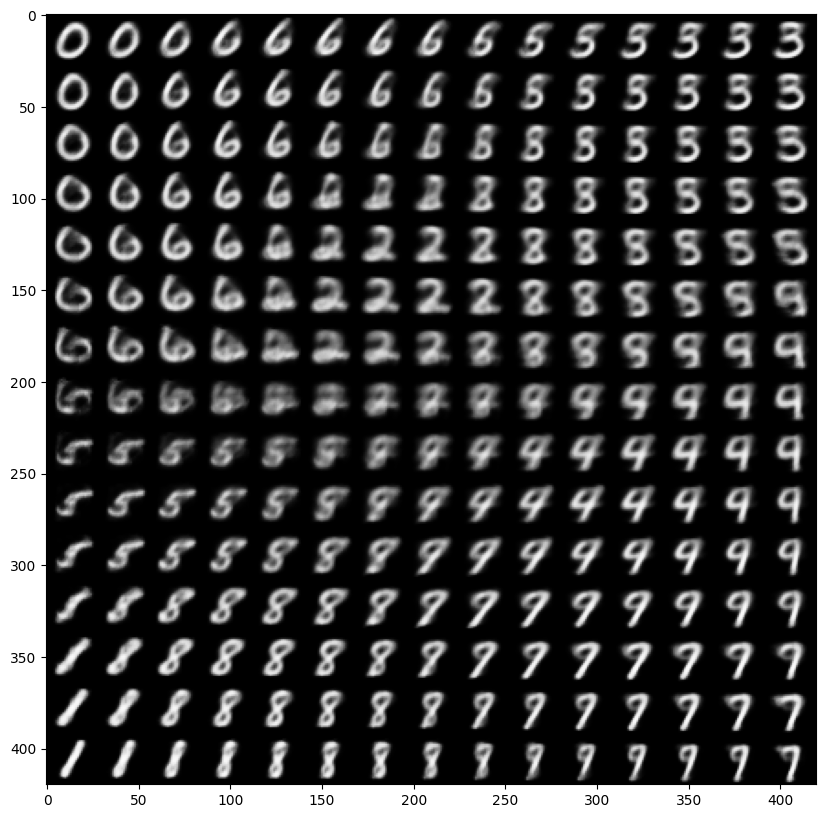

Train Epoch: 34 [0/60000 (0%)]	Loss: 152.153789
Train Epoch: 34 [10000/60000 (17%)]	Loss: 147.695938
Train Epoch: 34 [20000/60000 (33%)]	Loss: 154.513438
Train Epoch: 34 [30000/60000 (50%)]	Loss: 155.593018
Train Epoch: 34 [40000/60000 (67%)]	Loss: 149.036436
Train Epoch: 34 [50000/60000 (83%)]	Loss: 146.949111
====> Epoch: 34 Average loss: 149.1420
====> Test set loss: 151.2777


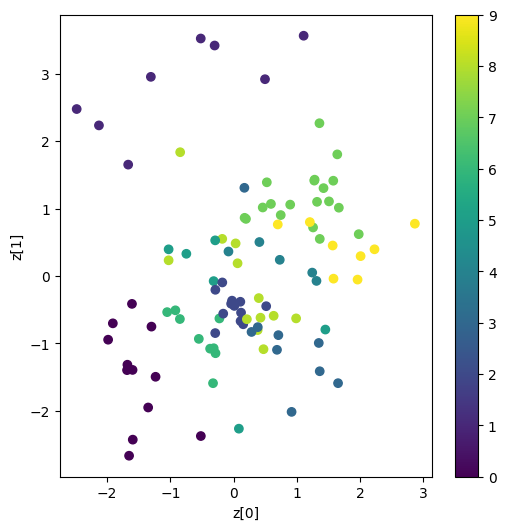

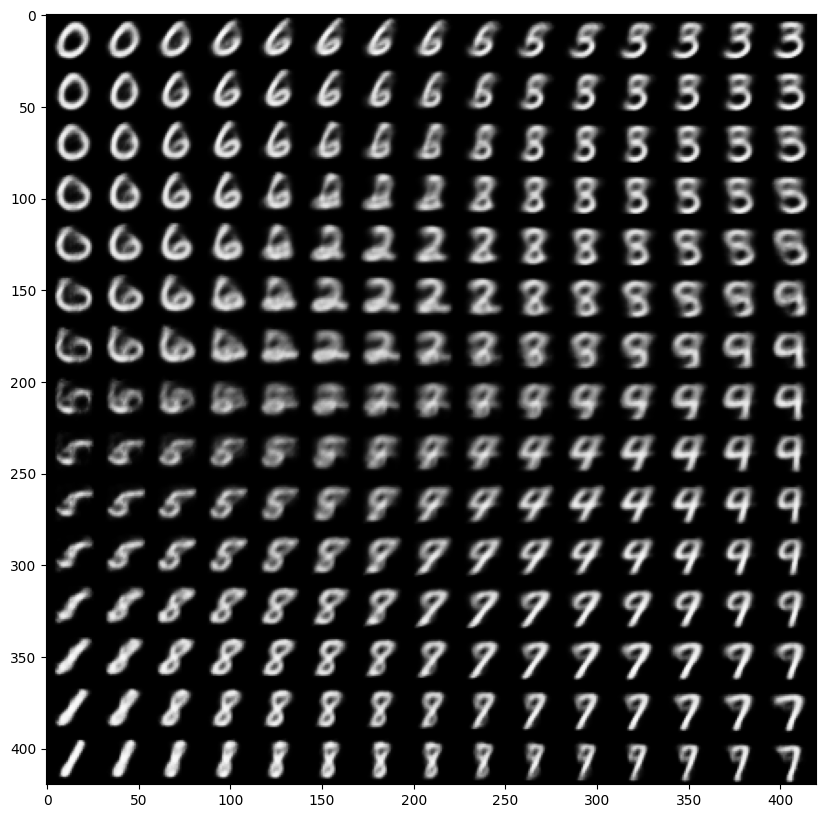

Train Epoch: 35 [0/60000 (0%)]	Loss: 149.901650
Train Epoch: 35 [10000/60000 (17%)]	Loss: 148.967578
Train Epoch: 35 [20000/60000 (33%)]	Loss: 156.674072
Train Epoch: 35 [30000/60000 (50%)]	Loss: 153.011455
Train Epoch: 35 [40000/60000 (67%)]	Loss: 144.222578
Train Epoch: 35 [50000/60000 (83%)]	Loss: 150.271816
====> Epoch: 35 Average loss: 148.9706
====> Test set loss: 151.3338


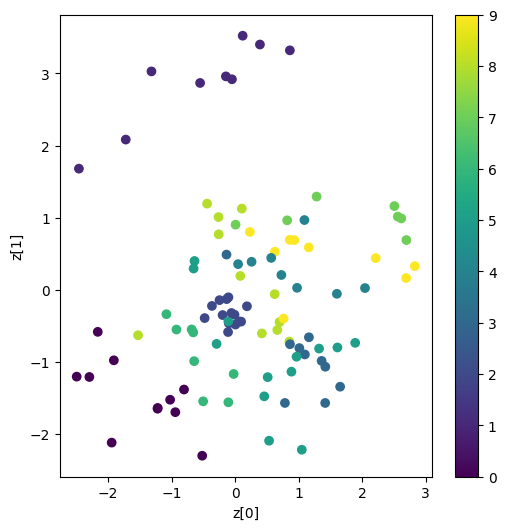

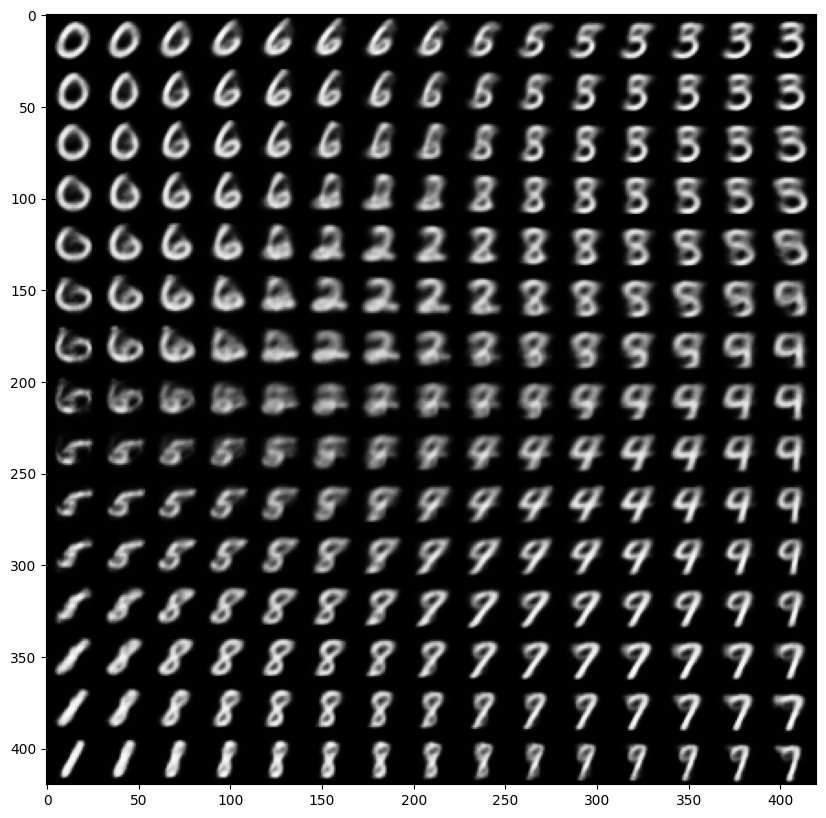

Train Epoch: 36 [0/60000 (0%)]	Loss: 147.580391
Train Epoch: 36 [10000/60000 (17%)]	Loss: 150.304902
Train Epoch: 36 [20000/60000 (33%)]	Loss: 151.895762
Train Epoch: 36 [30000/60000 (50%)]	Loss: 146.467227
Train Epoch: 36 [40000/60000 (67%)]	Loss: 146.429688
Train Epoch: 36 [50000/60000 (83%)]	Loss: 145.538916
====> Epoch: 36 Average loss: 148.8187
====> Test set loss: 150.8419


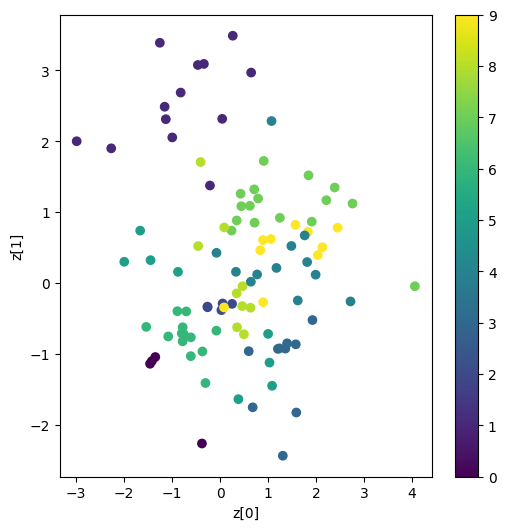

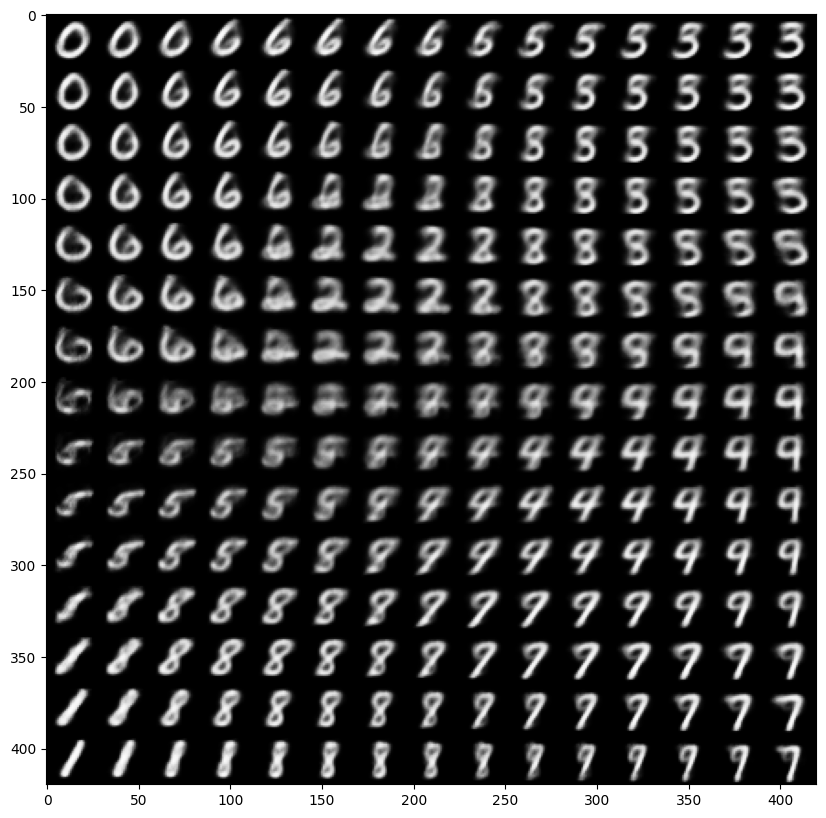

Train Epoch: 37 [0/60000 (0%)]	Loss: 147.034512
Train Epoch: 37 [10000/60000 (17%)]	Loss: 152.979746
Train Epoch: 37 [20000/60000 (33%)]	Loss: 144.736904
Train Epoch: 37 [30000/60000 (50%)]	Loss: 154.531465
Train Epoch: 37 [40000/60000 (67%)]	Loss: 152.394404
Train Epoch: 37 [50000/60000 (83%)]	Loss: 146.935605
====> Epoch: 37 Average loss: 148.6340
====> Test set loss: 151.3184


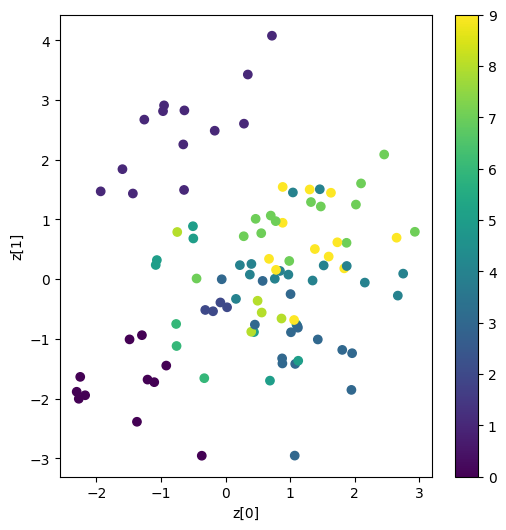

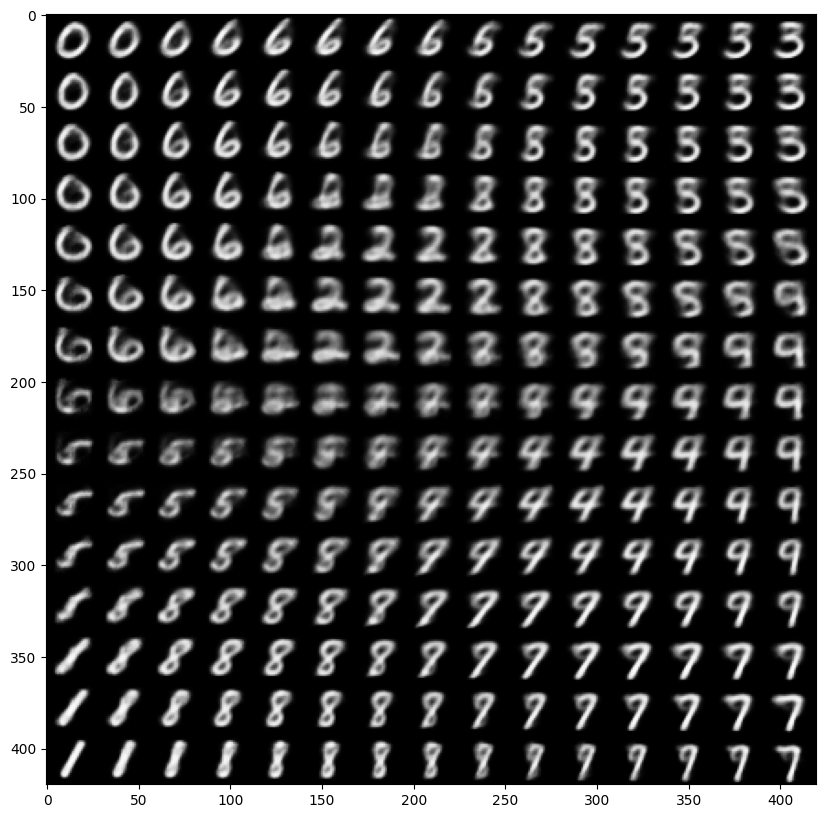

Train Epoch: 38 [0/60000 (0%)]	Loss: 153.833203
Train Epoch: 38 [10000/60000 (17%)]	Loss: 145.748594
Train Epoch: 38 [20000/60000 (33%)]	Loss: 144.930557
Train Epoch: 38 [30000/60000 (50%)]	Loss: 147.109072
Train Epoch: 38 [40000/60000 (67%)]	Loss: 141.066035
Train Epoch: 38 [50000/60000 (83%)]	Loss: 150.429258
====> Epoch: 38 Average loss: 148.4996
====> Test set loss: 151.0779


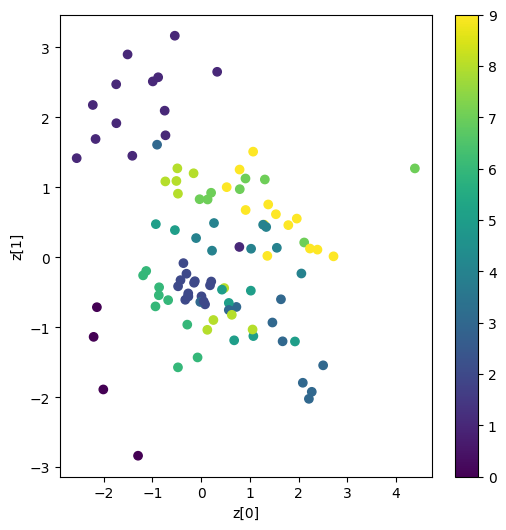

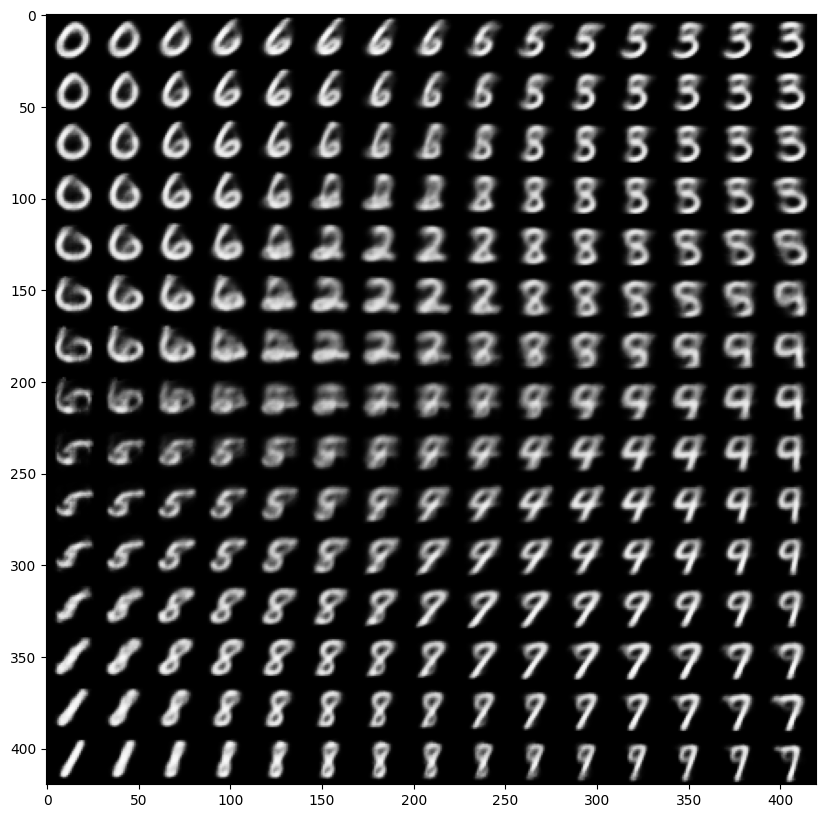

Train Epoch: 39 [0/60000 (0%)]	Loss: 145.142354
Train Epoch: 39 [10000/60000 (17%)]	Loss: 145.069570
Train Epoch: 39 [20000/60000 (33%)]	Loss: 150.398438
Train Epoch: 39 [30000/60000 (50%)]	Loss: 151.045820
Train Epoch: 39 [40000/60000 (67%)]	Loss: 148.775313
Train Epoch: 39 [50000/60000 (83%)]	Loss: 152.041152
====> Epoch: 39 Average loss: 148.3743
====> Test set loss: 150.6746


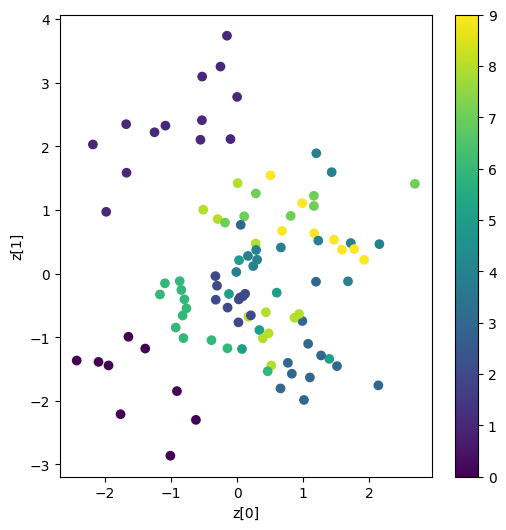

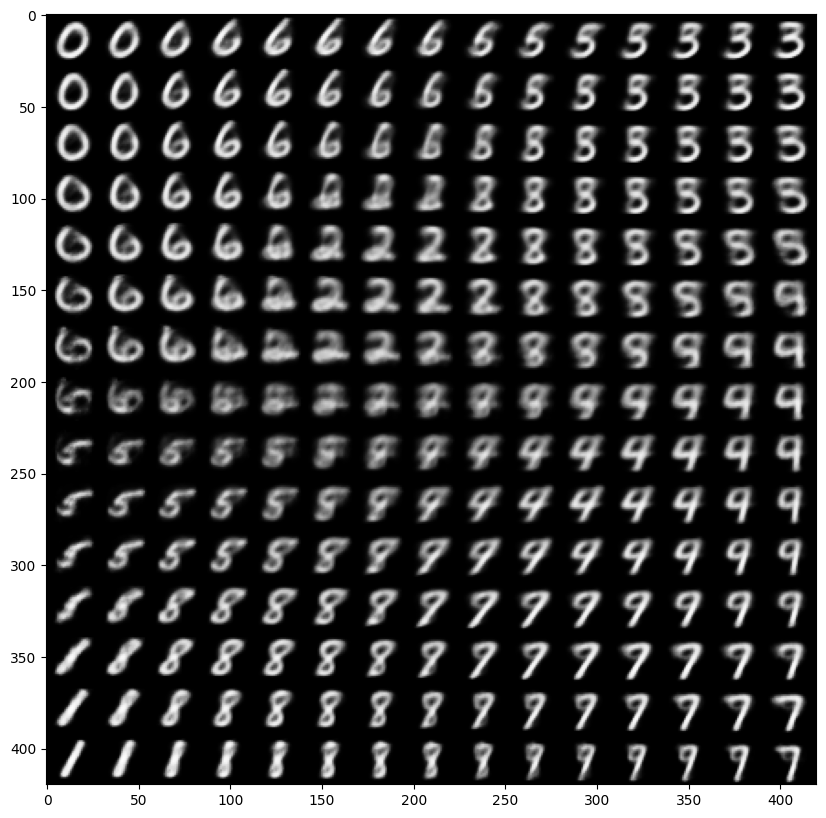

Train Epoch: 40 [0/60000 (0%)]	Loss: 145.990186
Train Epoch: 40 [10000/60000 (17%)]	Loss: 146.079531
Train Epoch: 40 [20000/60000 (33%)]	Loss: 153.665371
Train Epoch: 40 [30000/60000 (50%)]	Loss: 152.045293
Train Epoch: 40 [40000/60000 (67%)]	Loss: 129.333857
Train Epoch: 40 [50000/60000 (83%)]	Loss: 150.370195
====> Epoch: 40 Average loss: 148.2223
====> Test set loss: 150.7835


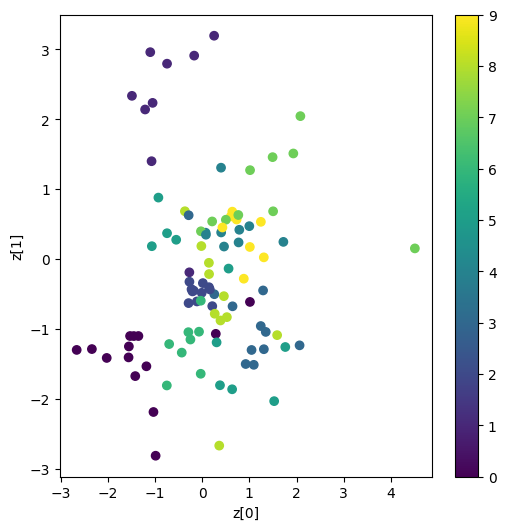

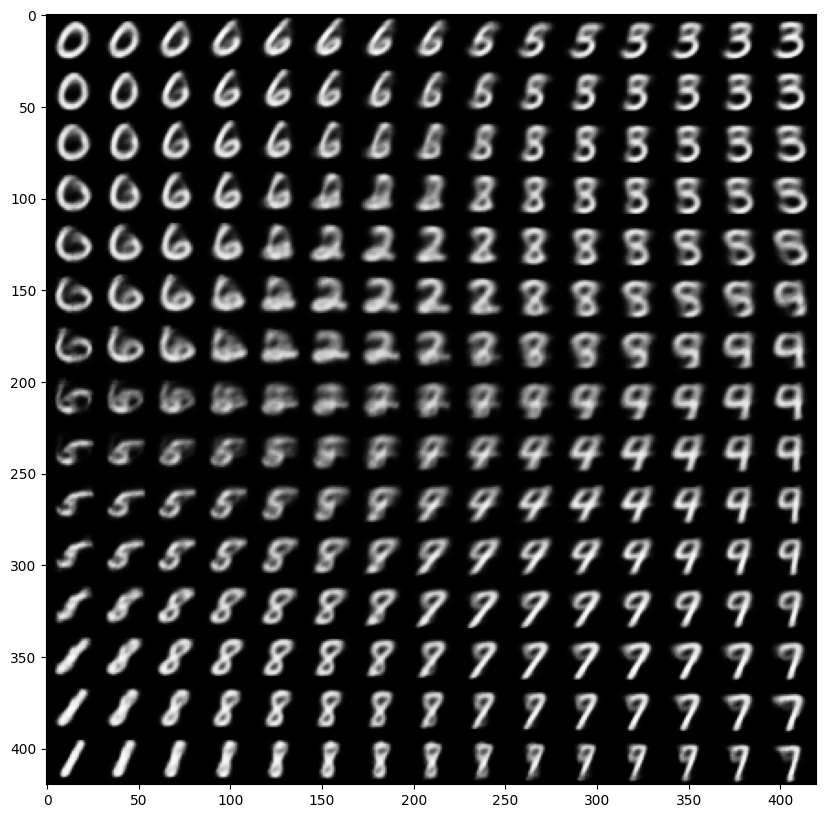

Train Epoch: 41 [0/60000 (0%)]	Loss: 147.375254
Train Epoch: 41 [10000/60000 (17%)]	Loss: 152.346094
Train Epoch: 41 [20000/60000 (33%)]	Loss: 147.271270
Train Epoch: 41 [30000/60000 (50%)]	Loss: 150.075176
Train Epoch: 41 [40000/60000 (67%)]	Loss: 147.508057
Train Epoch: 41 [50000/60000 (83%)]	Loss: 149.017256
====> Epoch: 41 Average loss: 148.0753
====> Test set loss: 150.4343


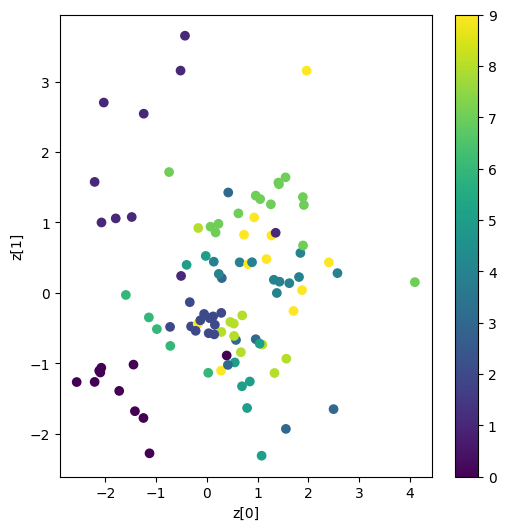

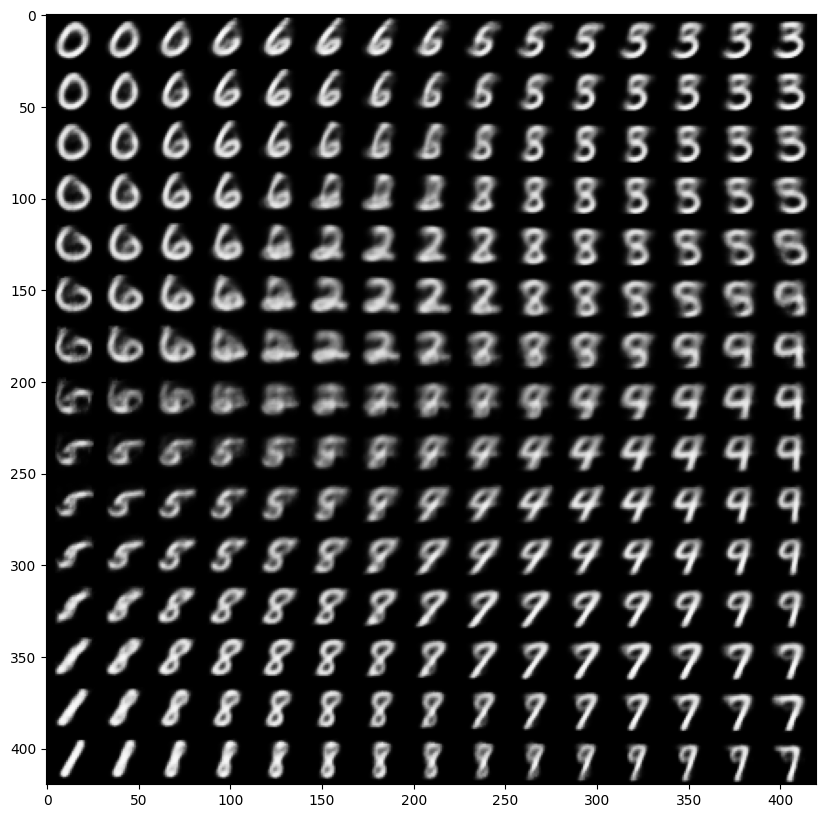

Train Epoch: 42 [0/60000 (0%)]	Loss: 152.196592
Train Epoch: 42 [10000/60000 (17%)]	Loss: 137.486191
Train Epoch: 42 [20000/60000 (33%)]	Loss: 144.532949
Train Epoch: 42 [30000/60000 (50%)]	Loss: 155.772139
Train Epoch: 42 [40000/60000 (67%)]	Loss: 155.650410
Train Epoch: 42 [50000/60000 (83%)]	Loss: 145.245186
====> Epoch: 42 Average loss: 147.9855
====> Test set loss: 150.4514


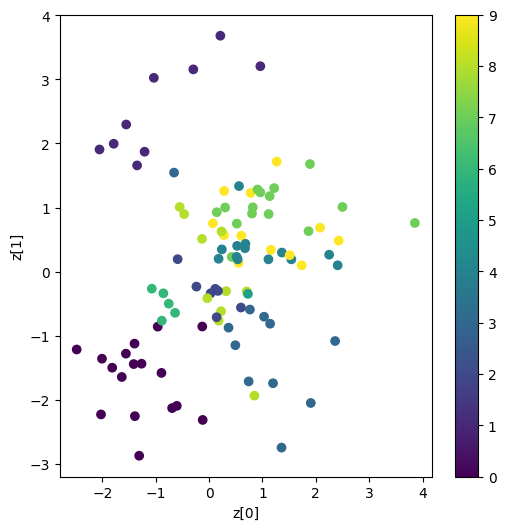

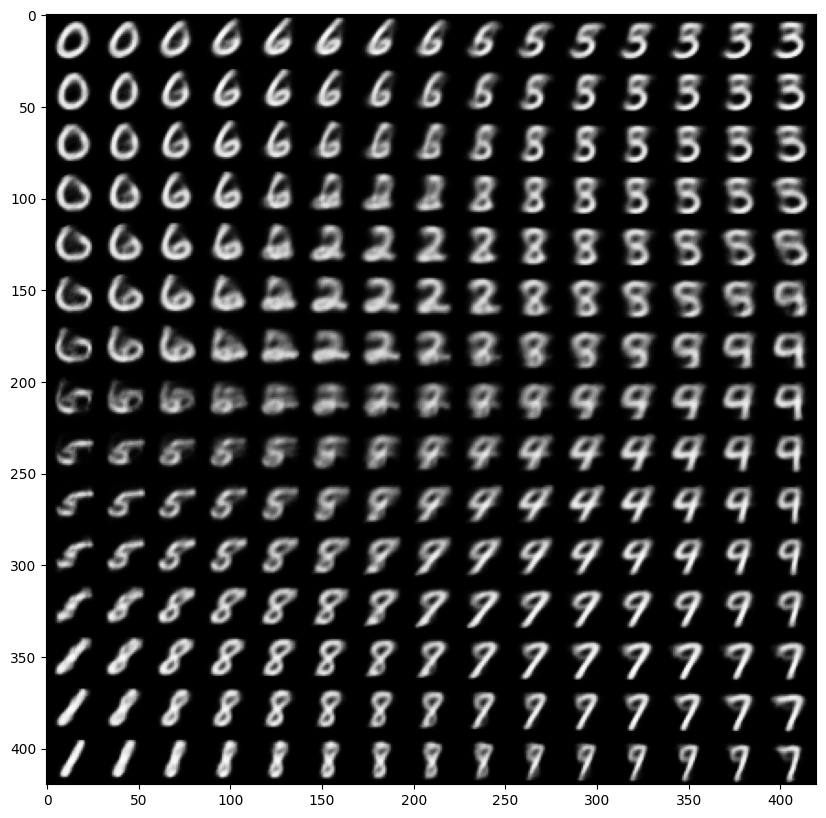

Train Epoch: 43 [0/60000 (0%)]	Loss: 144.660547
Train Epoch: 43 [10000/60000 (17%)]	Loss: 148.830684
Train Epoch: 43 [20000/60000 (33%)]	Loss: 141.555313
Train Epoch: 43 [30000/60000 (50%)]	Loss: 148.580215
Train Epoch: 43 [40000/60000 (67%)]	Loss: 140.998506
Train Epoch: 43 [50000/60000 (83%)]	Loss: 153.849941
====> Epoch: 43 Average loss: 147.8915
====> Test set loss: 150.5426


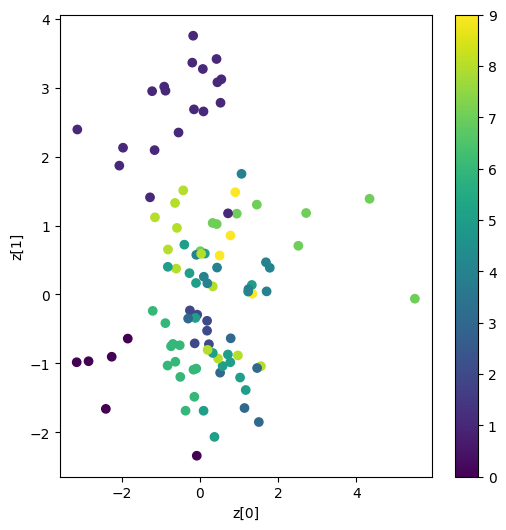

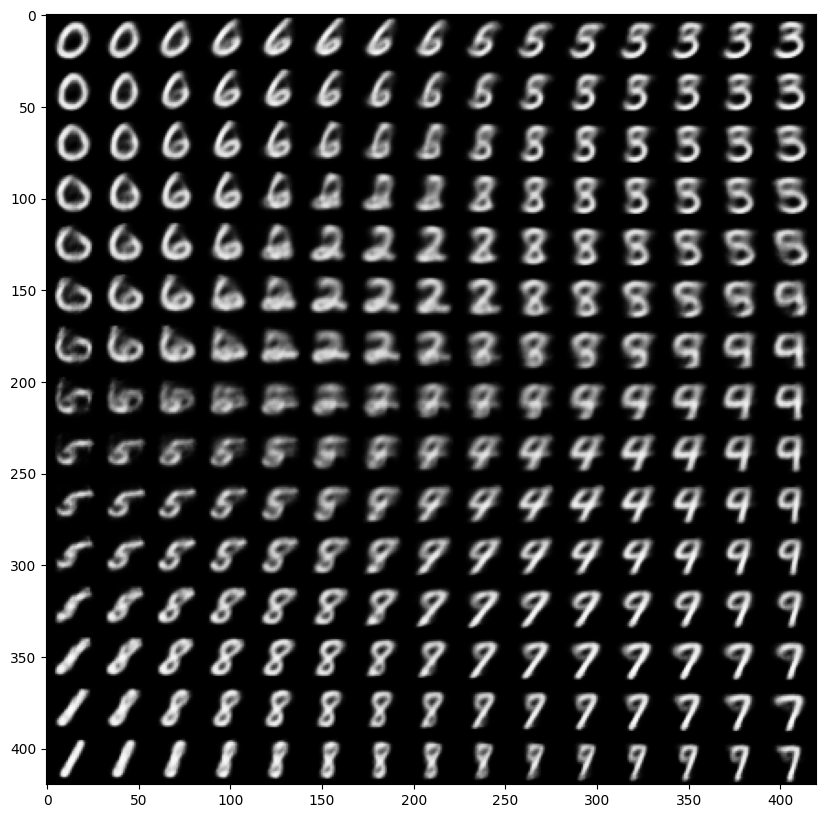

Train Epoch: 44 [0/60000 (0%)]	Loss: 155.612578
Train Epoch: 44 [10000/60000 (17%)]	Loss: 139.515527
Train Epoch: 44 [20000/60000 (33%)]	Loss: 145.674893
Train Epoch: 44 [30000/60000 (50%)]	Loss: 145.111846
Train Epoch: 44 [40000/60000 (67%)]	Loss: 155.932734
Train Epoch: 44 [50000/60000 (83%)]	Loss: 150.451504
====> Epoch: 44 Average loss: 147.7809
====> Test set loss: 150.3950


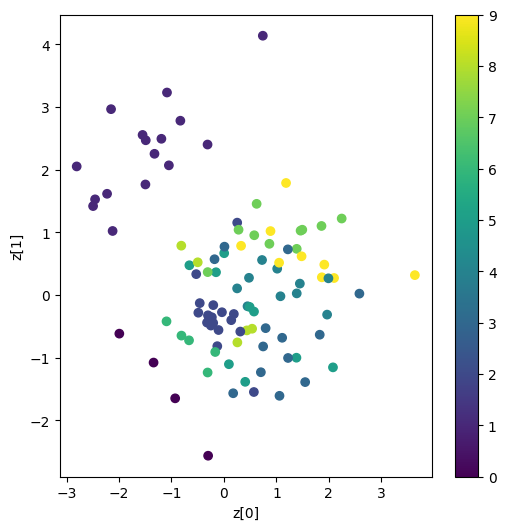

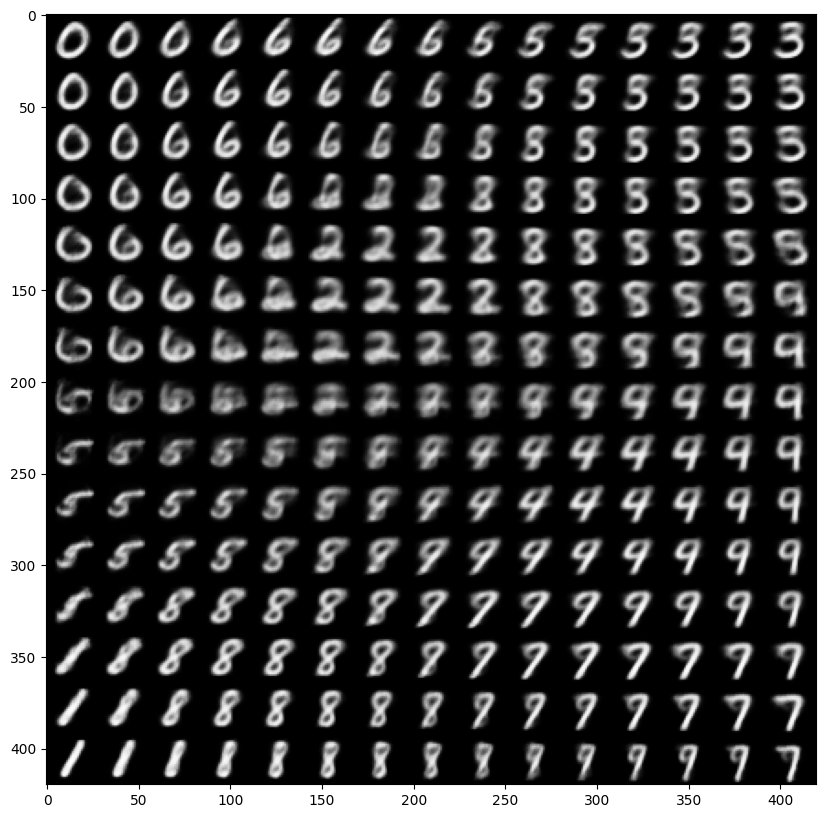

Train Epoch: 45 [0/60000 (0%)]	Loss: 142.229473
Train Epoch: 45 [10000/60000 (17%)]	Loss: 144.704775
Train Epoch: 45 [20000/60000 (33%)]	Loss: 151.370020
Train Epoch: 45 [30000/60000 (50%)]	Loss: 147.217187
Train Epoch: 45 [40000/60000 (67%)]	Loss: 152.989072
Train Epoch: 45 [50000/60000 (83%)]	Loss: 151.119033
====> Epoch: 45 Average loss: 147.5738
====> Test set loss: 150.4396


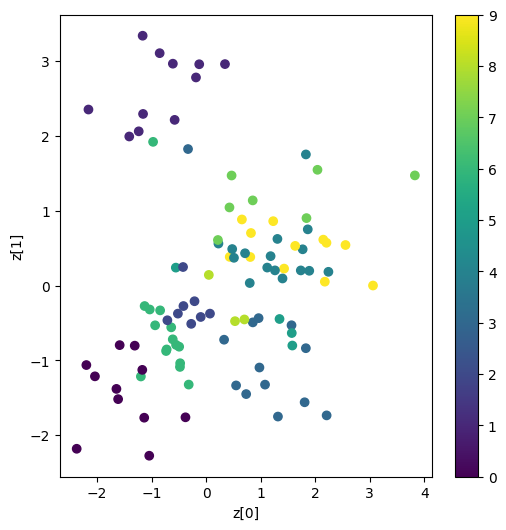

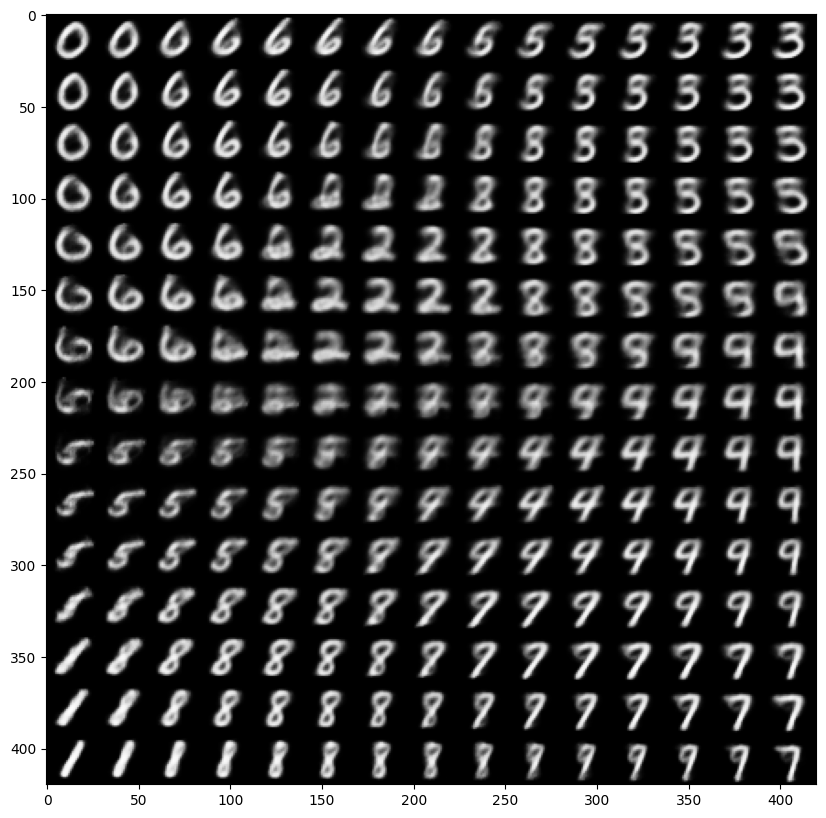

Train Epoch: 46 [0/60000 (0%)]	Loss: 147.375361
Train Epoch: 46 [10000/60000 (17%)]	Loss: 152.112002
Train Epoch: 46 [20000/60000 (33%)]	Loss: 143.698838
Train Epoch: 46 [30000/60000 (50%)]	Loss: 145.652646
Train Epoch: 46 [40000/60000 (67%)]	Loss: 157.222432
Train Epoch: 46 [50000/60000 (83%)]	Loss: 141.888652
====> Epoch: 46 Average loss: 147.4600
====> Test set loss: 150.5502


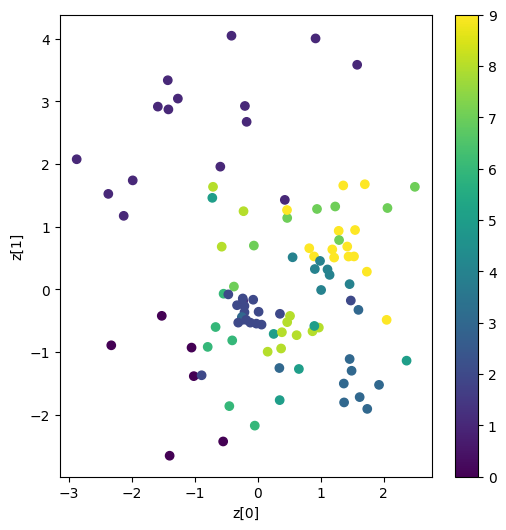

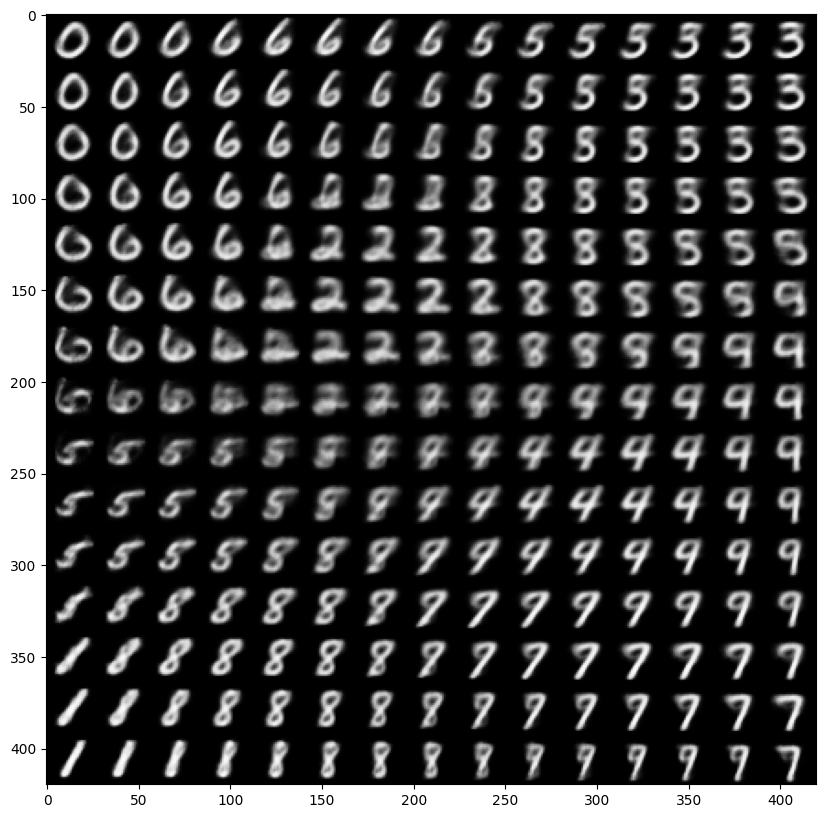

Train Epoch: 47 [0/60000 (0%)]	Loss: 150.070078
Train Epoch: 47 [10000/60000 (17%)]	Loss: 144.336201
Train Epoch: 47 [20000/60000 (33%)]	Loss: 156.162383
Train Epoch: 47 [30000/60000 (50%)]	Loss: 139.285693
Train Epoch: 47 [40000/60000 (67%)]	Loss: 151.205996
Train Epoch: 47 [50000/60000 (83%)]	Loss: 147.110166
====> Epoch: 47 Average loss: 147.4570
====> Test set loss: 150.2013


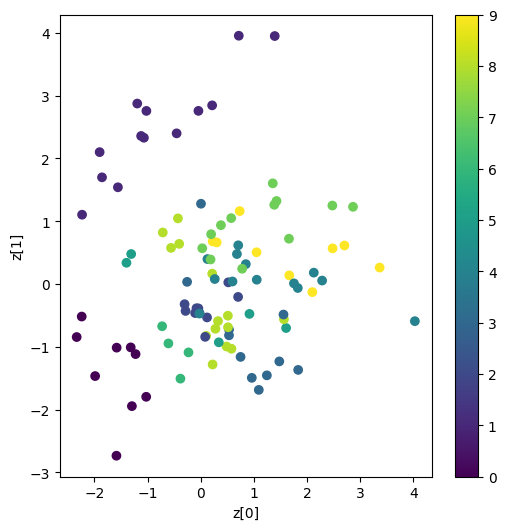

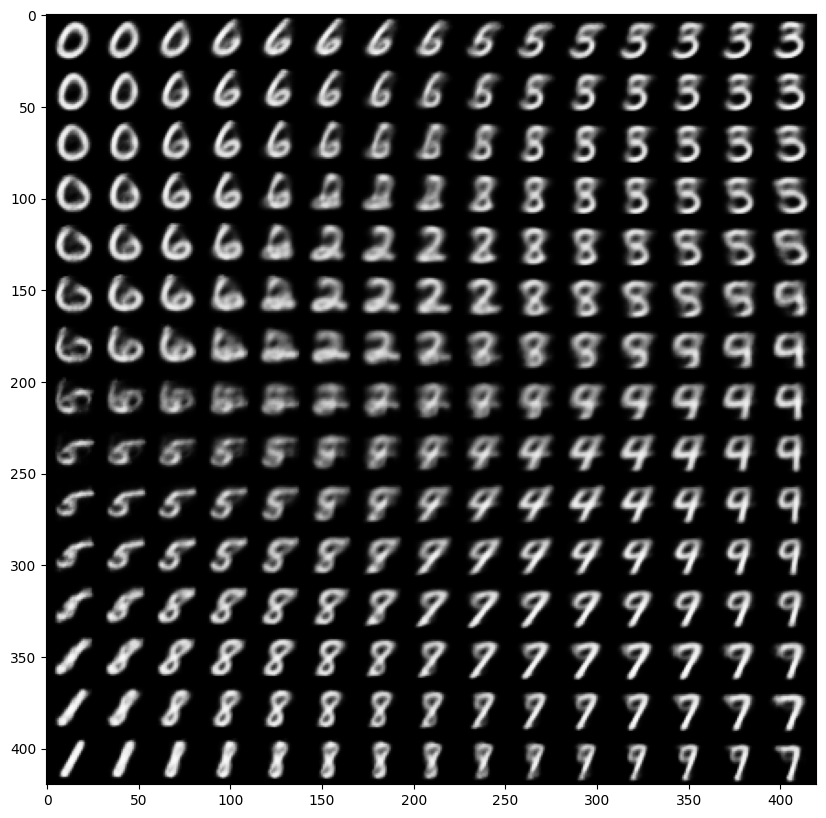

Train Epoch: 48 [0/60000 (0%)]	Loss: 148.135039
Train Epoch: 48 [10000/60000 (17%)]	Loss: 151.108418
Train Epoch: 48 [20000/60000 (33%)]	Loss: 145.115381
Train Epoch: 48 [30000/60000 (50%)]	Loss: 141.366113
Train Epoch: 48 [40000/60000 (67%)]	Loss: 154.709795
Train Epoch: 48 [50000/60000 (83%)]	Loss: 150.914922
====> Epoch: 48 Average loss: 147.2786
====> Test set loss: 150.8992


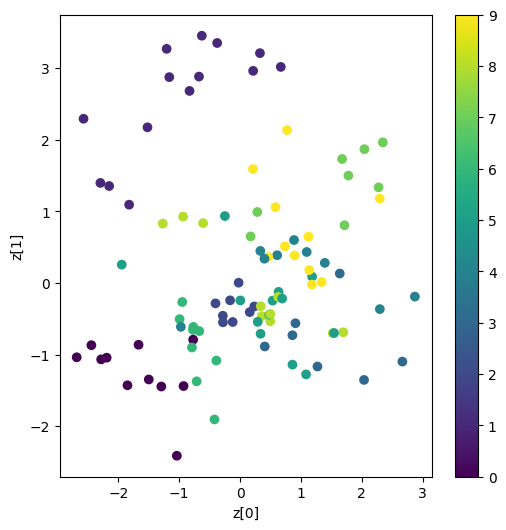

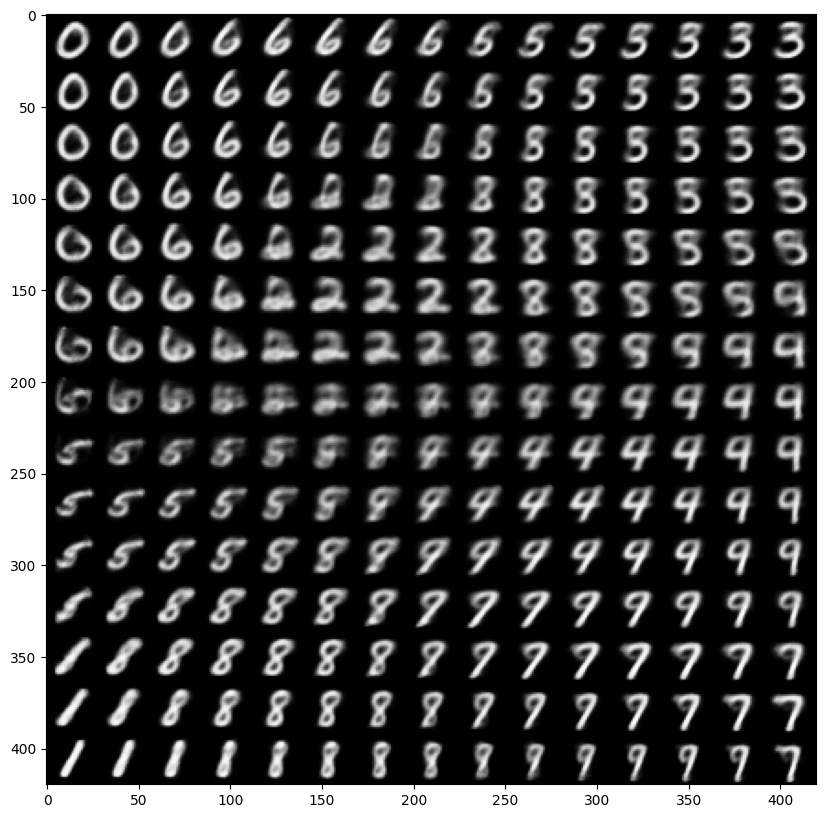

Train Epoch: 49 [0/60000 (0%)]	Loss: 140.782656
Train Epoch: 49 [10000/60000 (17%)]	Loss: 144.129121
Train Epoch: 49 [20000/60000 (33%)]	Loss: 146.575537
Train Epoch: 49 [30000/60000 (50%)]	Loss: 149.457148
Train Epoch: 49 [40000/60000 (67%)]	Loss: 147.329941
Train Epoch: 49 [50000/60000 (83%)]	Loss: 152.470020
====> Epoch: 49 Average loss: 147.2333
====> Test set loss: 150.0845


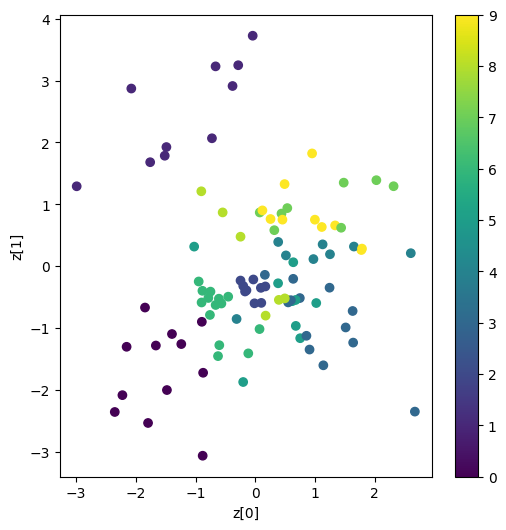

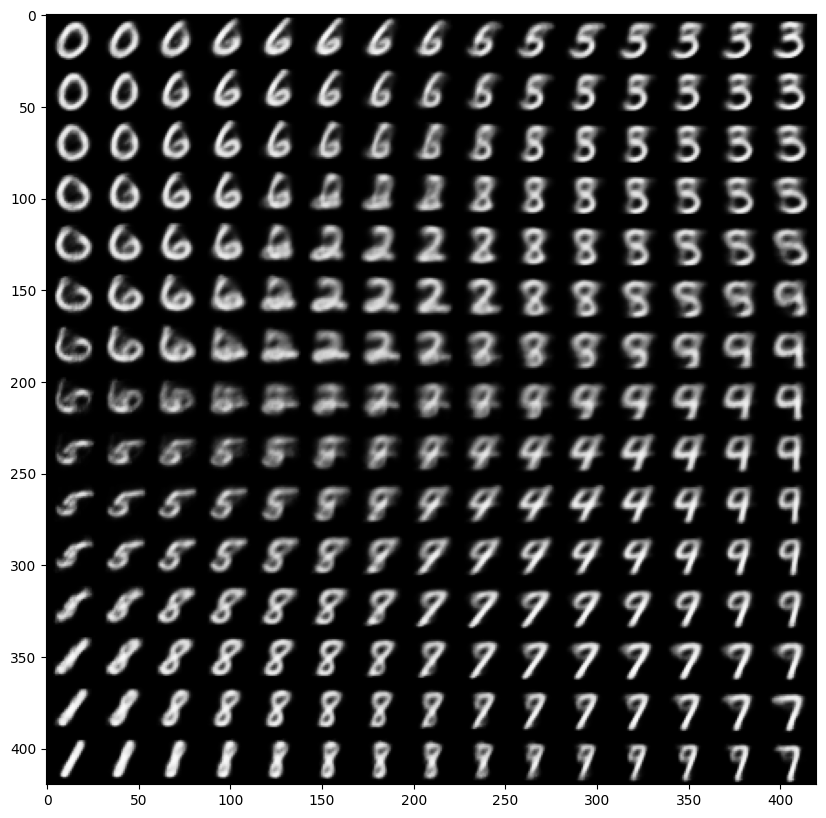

Train Epoch: 50 [0/60000 (0%)]	Loss: 149.834902
Train Epoch: 50 [10000/60000 (17%)]	Loss: 146.269463
Train Epoch: 50 [20000/60000 (33%)]	Loss: 147.245029
Train Epoch: 50 [30000/60000 (50%)]	Loss: 154.819629
Train Epoch: 50 [40000/60000 (67%)]	Loss: 147.935898
Train Epoch: 50 [50000/60000 (83%)]	Loss: 157.812695
====> Epoch: 50 Average loss: 147.0916
====> Test set loss: 150.2853


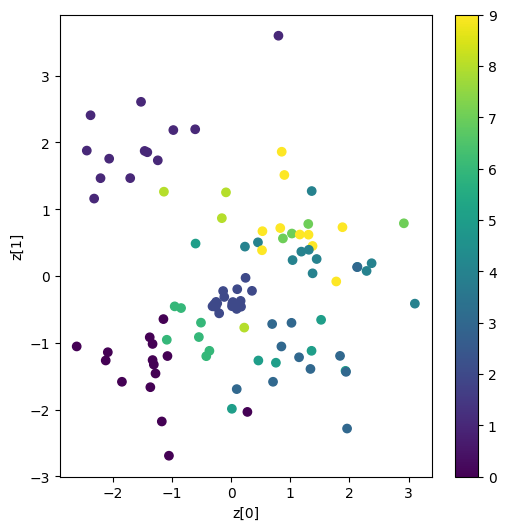

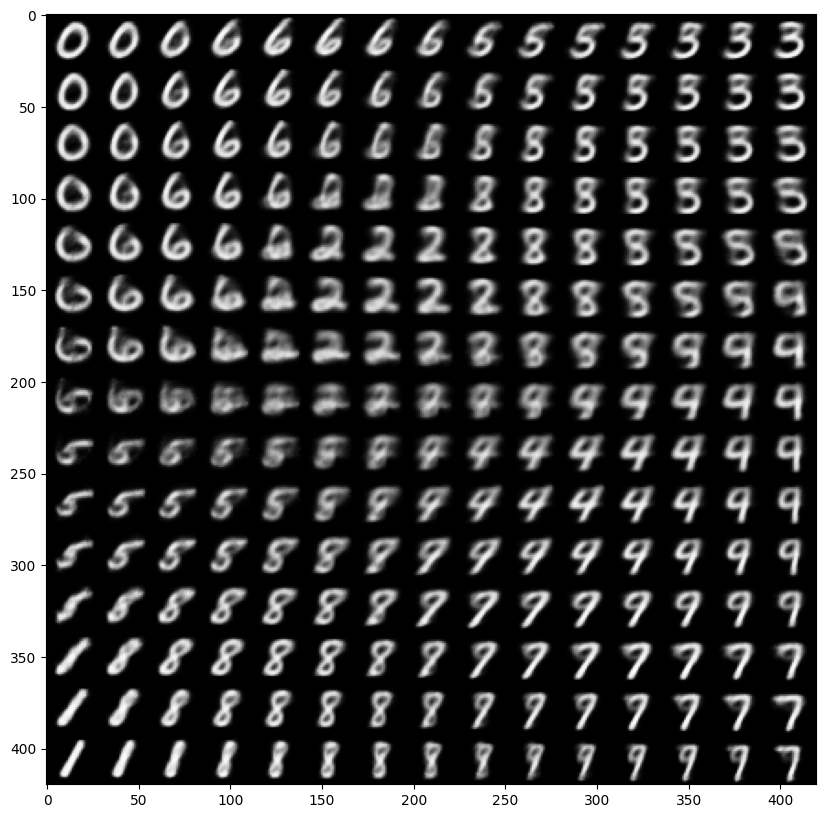

In [16]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = VAE().to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)

for epoch in range(1, epochs + 1):
  train(epoch)
  test(epoch)
  plot_latent_space(epoch)
  plot_generated_images(epoch)